<p style="font-size:32px;text-align:center"> <b>Social network Graph Link Prediction - Facebook Challenge</b> </p>

### Problem statement: 
Given a directed social graph, have to predict missing links to recommend users (Link Prediction in graph)

### Data Overview
Taken data from facebook's recruting challenge on kaggle https://www.kaggle.com/c/FacebookRecruiting  
data contains two columns source and destination eac edge in graph 
    - Data columns (total 2 columns):  
    - source_node         int64  
    - destination_node    int64  

### Mapping the problem into supervised learning problem:
- Generated training samples of good and bad links from given directed graph and for each link got some features like no of followers, is he followed back, page rank, katz score, adar index, some svd fetures of adj matrix, some weight features etc. and trained ml model based on these features to predict link. 
- Some reference papers and videos :  
    - https://www.cs.cornell.edu/home/kleinber/link-pred.pdf
    - https://www3.nd.edu/~dial/publications/lichtenwalter2010new.pdf
    - https://www.youtube.com/watch?v=2M77Hgy17cg

### Business objectives and constraints:  
- No low-latency requirement.
- Probability of prediction is useful to recommend ighest probability links

### Performance metric for supervised learning:  
- Both precision and recall is important so F1 score is good choice
- Confusion matrix

In [ ]:
#Importing Libraries
# please do go through this python notebook: 
import warnings
warnings.filterwarnings("ignore")

import csv
import pandas as pd#pandas to create small dataframes 
import datetime #Convert to unix time
import time #Convert to unix time
# if numpy is not installed already : pip3 install numpy
import numpy as np#Do aritmetic operations on arrays
# matplotlib: used to plot graphs
import matplotlib
import matplotlib.pylab as plt
import seaborn as sns#Plots
from matplotlib import rcParams#Size of plots  
from sklearn.cluster import MiniBatchKMeans, KMeans#Clustering
import math
import pickle
import os
# to install xgboost: pip3 install xgboost
import xgboost as xgb

import warnings
import networkx as nx
import pdb
import pickle

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [ ]:
#reading graph
g=nx.read_edgelist('/content/drive/My Drive/AppliedAI-Practice/Facebook/data/after_eda/train_woheader.csv',delimiter=',',create_using=nx.DiGraph(),nodetype=int)
print(nx.info(g))

Name: 
Type: DiGraph
Number of nodes: 1862220
Number of edges: 9437519
Average in degree:   5.0679
Average out degree:   5.0679


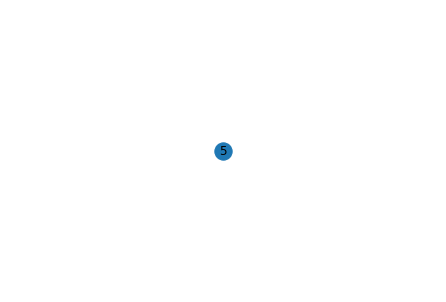

In [ ]:
nx.draw(g.subgraph(5),with_labels=True)

> Displaying a sub graph

In [ ]:
data_fb = pd.read_csv('/content/drive/My Drive/AppliedAI-Practice/Facebook/data/after_eda/train_woheader.csv',nrows = 200)
data_fb.head(10)

,1,690569
0,1,315892
1,1,189226
2,2,834328
3,2,1615927
4,2,1194519
5,2,470294
6,2,961886
7,2,626040
8,3,176995
9,3,624722


In [ ]:
a = pd.read_csv('/content/drive/My Drive/AppliedAI-Practice/Facebook/data/train.csv',nrows = 200)
a.head(10)

,source_node,destination_node
0,1,690569
1,1,315892
2,1,189226
3,2,834328
4,2,1615927
5,2,1194519
6,2,470294
7,2,961886
8,2,626040
9,3,176995


# 1. Exploratory Data Analysis

number of nodes

In [ ]:
# No of Unique persons 
print("The number of unique persons",len(g.nodes()))

The number of unique persons 1862220


## 1.1 No of followers for each person

In [ ]:
g.in_degree()

InDegreeView({1: 3, 690569: 29, 315892: 28, 189226: 3, 2: 4, 834328: 71, 1615927: 36, 1194519: 17, 470294: 21, 961886: 12, 626040: 5, 3: 11, 176995: 17, 624722: 39, 412447: 16, 1263124: 20, 278432: 4, 539336: 5, 4: 1, 6271: 29, 1859286: 9, 5: 2, 1646876: 12, 677005: 4, 6: 1, 1576703: 20, 7: 3, 1760879: 1, 80397: 3, 778186: 3, 8: 1, 772194: 2, 9: 2, 296377: 8, 1657609: 4, 10: 0, 31186: 45, 11: 0, 572660: 14, 12: 3, 1244587: 12, 456253: 12, 708009: 2, 13: 12, 206036: 10, 1244435: 31, 28583: 59, 1771842: 33, 1589497: 29, 731455: 27, 328678: 2, 1324981: 4, 431522: 7, 531778: 4, 680313: 1, 37329: 2, 14: 1, 382658: 15, 15: 1, 7462: 16, 18: 13, 619456: 2, 316287: 15, 795106: 23, 578933: 30, 1246523: 10, 1323975: 11, 984426: 4, 1003537: 3, 1468933: 2, 1688534: 6, 1269182: 9, 1753748: 3, 248374: 6, 1377966: 13, 78146: 2, 19: 0, 254810: 8, 860701: 7, 1205150: 5, 220385: 1, 401594: 1, 20: 0, 493028: 94, 21: 1, 212060: 6, 22: 1, 57396: 1, 24: 4, 322832: 11, 423929: 4, 1435: 3, 1310872: 2, 25: 21, 

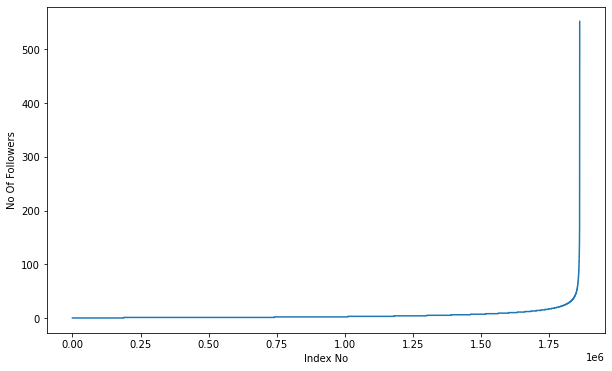

1862220


In [ ]:
indegree_dist = list(dict(g.in_degree()).values())
indegree_dist.sort()
plt.figure(figsize=(10,6))
plt.plot(indegree_dist)
plt.xlabel('Index No')
plt.ylabel('No Of Followers')
plt.show()
print(len(indegree_dist))

we take only till 16 lakh as in graph it shows spike starts at 16 lakh

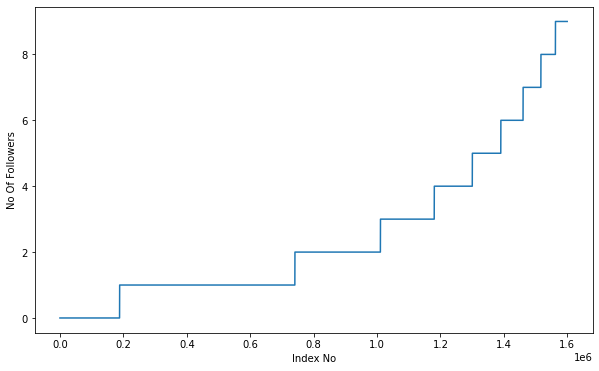

In [ ]:
indegree_dist = list(dict(g.in_degree()).values())
indegree_dist.sort()
plt.figure(figsize=(10,6))
plt.plot(indegree_dist[0:1600000])
plt.xlabel('Index No')
plt.ylabel('No Of Followers')
plt.show()

so till 16 lakh number of followers are almost 8

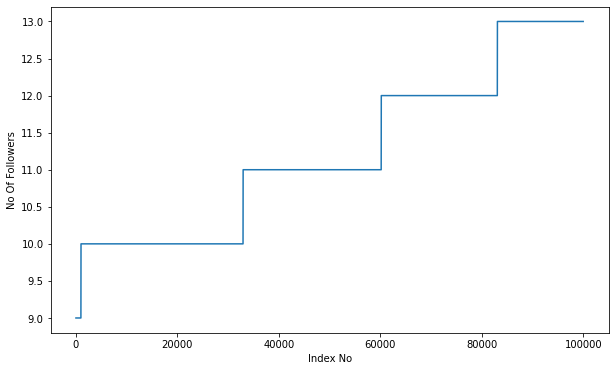

In [ ]:
indegree_dist = list(dict(g.in_degree()).values())
indegree_dist.sort()
plt.figure(figsize=(10,6))
plt.plot(indegree_dist[1600000:1700000])
plt.xlabel('Index No')
plt.ylabel('No Of Followers')
plt.show()

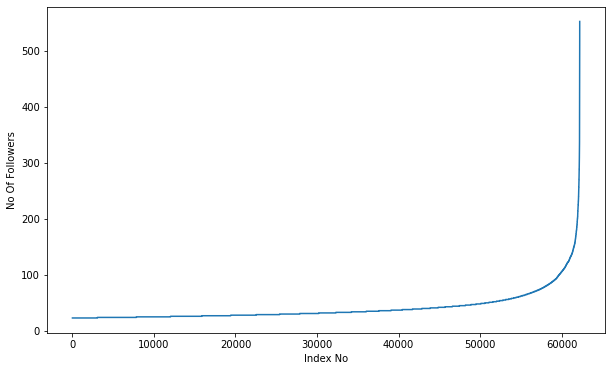

In [ ]:
indegree_dist = list(dict(g.in_degree()).values())
indegree_dist.sort()
plt.figure(figsize=(10,6))
plt.plot(indegree_dist[1800000:len(indegree_dist)])
plt.xlabel('Index No')
plt.ylabel('No Of Followers')
plt.show()

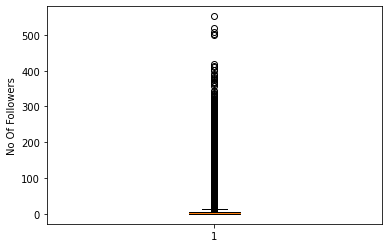

In [ ]:
plt.boxplot(indegree_dist)
plt.ylabel('No Of Followers')
plt.show()

In [ ]:
### 90-100 percentile
for i in range(0,11):
    print(90+i,'percentile value is',np.percentile(indegree_dist,90+i))

90 percentile value is 12.0
91 percentile value is 13.0
92 percentile value is 14.0
93 percentile value is 15.0
94 percentile value is 17.0
95 percentile value is 19.0
96 percentile value is 21.0
97 percentile value is 24.0
98 percentile value is 29.0
99 percentile value is 40.0
100 percentile value is 552.0


99% of data having followers of 40 only.

In [ ]:
### 99-100 percentile
for i in range(10,110,10):
    print(99+(i/100),'percentile value is',np.percentile(indegree_dist,99+(i/100)))

99.1 percentile value is 42.0
99.2 percentile value is 44.0
99.3 percentile value is 47.0
99.4 percentile value is 50.0
99.5 percentile value is 55.0
99.6 percentile value is 61.0
99.7 percentile value is 70.0
99.8 percentile value is 84.0
99.9 percentile value is 112.0
100.0 percentile value is 552.0


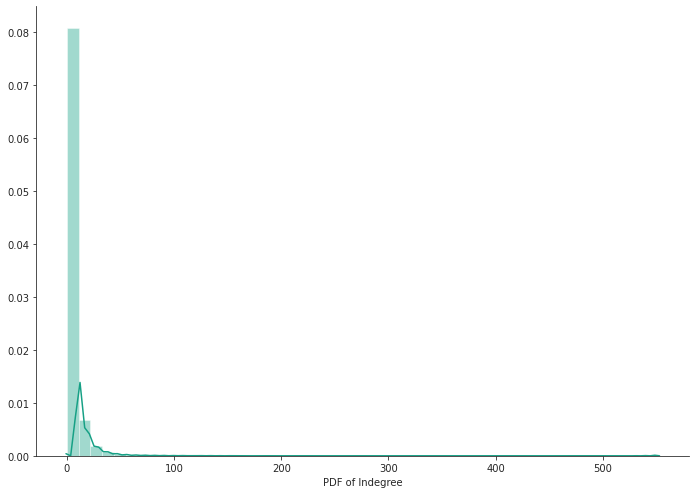

In [ ]:
%matplotlib inline
sns.set_style('ticks')
fig, ax = plt.subplots()
fig.set_size_inches(11.7, 8.27)
sns.distplot(indegree_dist, color='#16A085')
plt.xlabel('PDF of Indegree')
sns.despine()
#plt.show()

## 1.2 No of people each person is following

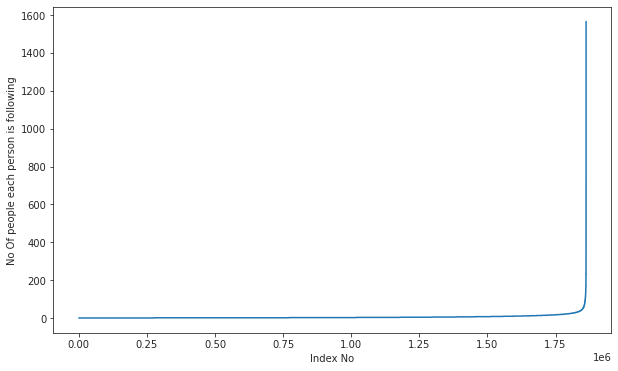

In [ ]:
outdegree_dist = list(dict(g.out_degree()).values())
outdegree_dist.sort()
plt.figure(figsize=(10,6))
plt.plot(outdegree_dist)
plt.xlabel('Index No')
plt.ylabel('No Of people each person is following')
plt.show()

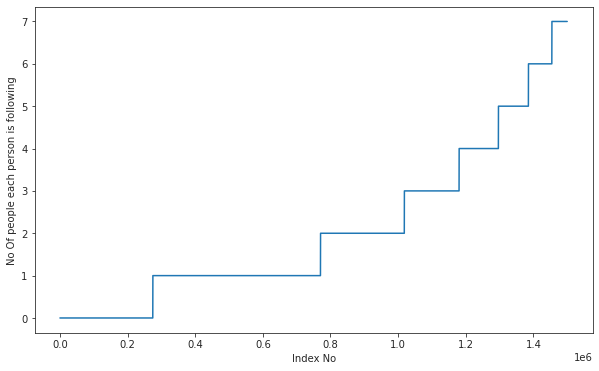

In [ ]:
outdegree_dist = list(dict(g.out_degree()).values())
outdegree_dist.sort()
plt.figure(figsize=(10,6))
plt.plot(outdegree_dist[0:1500000])
plt.xlabel('Index No')
plt.ylabel('No Of people each person is following')
plt.show()

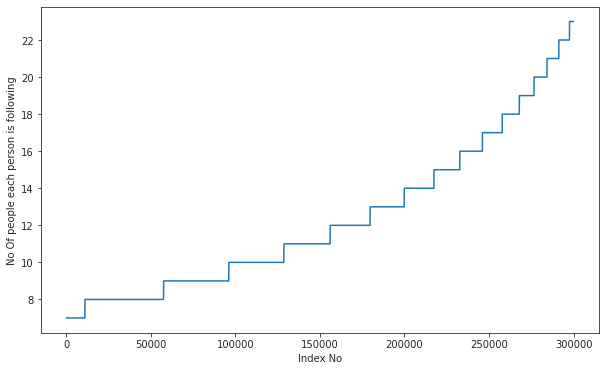

In [ ]:
outdegree_dist = list(dict(g.out_degree()).values())
outdegree_dist.sort()
plt.figure(figsize=(10,6))
plt.plot(outdegree_dist[1500000:1800000])
plt.xlabel('Index No')
plt.ylabel('No Of people each person is following')
plt.show()

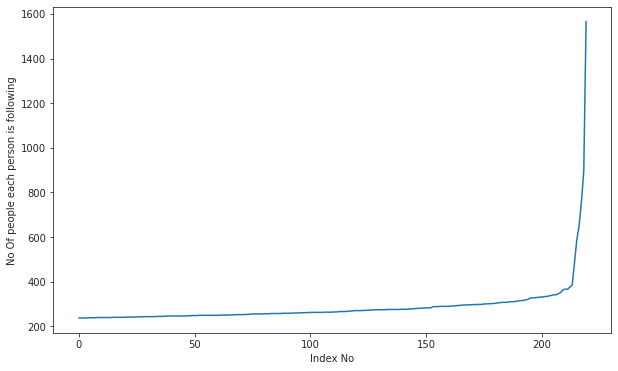

1862220


In [ ]:
outdegree_dist = list(dict(g.out_degree()).values())
outdegree_dist.sort()
plt.figure(figsize=(10,6))
plt.plot(outdegree_dist[1862000:])
plt.xlabel('Index No')
plt.ylabel('No Of people each person is following')
plt.show()
print(len(outdegree_dist))

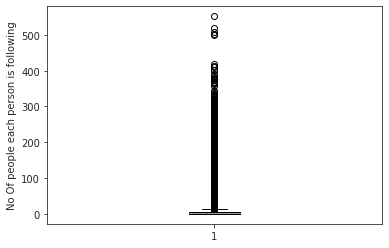

In [ ]:
plt.boxplot(indegree_dist)
plt.ylabel('No Of people each person is following')
plt.show()

In [ ]:
### 90-100 percentile
for i in range(0,11):
    print(90+i,'percentile value is',np.percentile(outdegree_dist,90+i))

90 percentile value is 12.0
91 percentile value is 13.0
92 percentile value is 14.0
93 percentile value is 15.0
94 percentile value is 17.0
95 percentile value is 19.0
96 percentile value is 21.0
97 percentile value is 24.0
98 percentile value is 29.0
99 percentile value is 40.0
100 percentile value is 1566.0


In [ ]:
### 99-100 percentile
for i in range(10,110,10):
    print(99+(i/100),'percentile value is',np.percentile(outdegree_dist,99+(i/100)))

99.1 percentile value is 42.0
99.2 percentile value is 45.0
99.3 percentile value is 48.0
99.4 percentile value is 52.0
99.5 percentile value is 56.0
99.6 percentile value is 63.0
99.7 percentile value is 73.0
99.8 percentile value is 90.0
99.9 percentile value is 123.0
100.0 percentile value is 1566.0


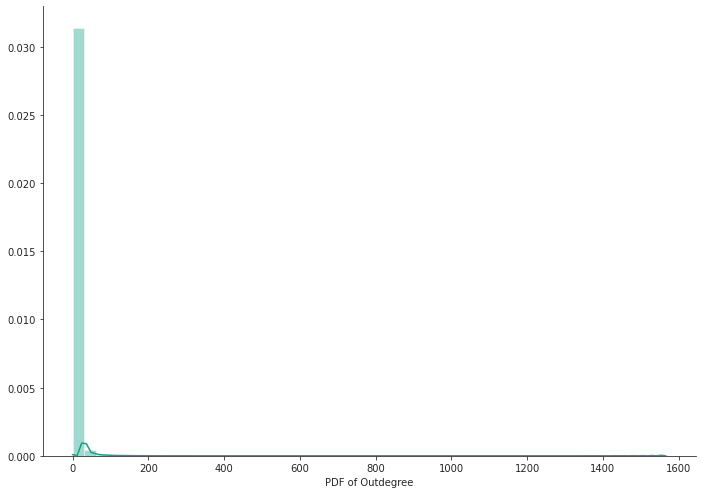

In [ ]:
sns.set_style('ticks')
fig, ax = plt.subplots()
fig.set_size_inches(11.7, 8.27)
sns.distplot(outdegree_dist, color='#16A085')
plt.xlabel('PDF of Outdegree')
sns.despine()

In [ ]:
len(outdegree_dist)

1862220

In [ ]:
sum(np.array(outdegree_dist)!=0)

1587708

below code tells that 274512 people have 0 followers

In [ ]:
sum(np.array(outdegree_dist)==0)

274512

In [ ]:
print('No of persons those are not following anyone are' ,sum(np.array(outdegree_dist)==0),'and % is',
                                sum(np.array(outdegree_dist)==0)*100/len(outdegree_dist) )

No of persons those are not following anyone are 274512 and % is 14.741115442858524


In [ ]:
print('No of persons having zero followers are' ,sum(np.array(indegree_dist)==0),'and % is',
                                sum(np.array(indegree_dist)==0)*100/len(indegree_dist) )

No of persons having zero followers are 188043 and % is 10.097786512871734


examples of predecessors and successors

In [ ]:
# Gs = nx.DiGraph() # a directed graph
# Gs.add_edge('a', 'b')
# print(list(Gs.predecessors('b')))

['a']


In [ ]:
# Gs = nx.DiGraph() # a directed graph
# Gs.add_edge('b', 'a')
# print(list(Gs.successors('b')))
# print(list(Gs.successors('a')))

['a']
[]


In [ ]:
count=0
for i in g.nodes():
    if len(list(g.predecessors(i)))==0 :
        if len(list(g.successors(i)))==0:
            count+=1
print('No of persons those are not not following anyone and also not having any followers are',count)

No of persons those are not not following anyone and also not having any followers are 0


## 1.3 both followers + following 

in_out_degree consists of both folowwers and following data


in_degree following data

out_degree followers data

together store into a dict

so in_degree means a,b meand a---->b   b has in_degree 1

so out_degree means a,b meand a<----b   a has in_degree 1

from counter we get values of in_degree and out_degree we aadd them together 

In [ ]:
# from collections import Counter
# Gs = nx.DiGraph() # a directed graph
# Gs.add_edges_from([('A', 'B'), ('A', 'C'), ('D', 'B')])
# dict_in_s = dict(Gs.in_degree())
# dict_out_s = dict(Gs.out_degree())
# print(dict_in_s)
# print(dict_out_s)
# print(Counter(dict_in_s))
# print(Counter(dict_out_s))
# print(Counter(dict_in_s) + Counter(dict_out_s))
# np.array(list((Counter(dict_in_s) + Counter(dict_out_s)).values()))

In [ ]:
from collections import Counter
dict_in = dict(g.in_degree())
dict_out = dict(g.out_degree())
d = Counter(dict_in) + Counter(dict_out)
in_out_degree = np.array(list(d.values()))

In [ ]:
in_out_degree.shape

(1862220,)

In [ ]:
print(list(dict_in)[:5])

[1, 690569, 315892, 189226, 2]


In [ ]:
print(list(dict_out)[:5])

[1, 690569, 315892, 189226, 2]


In [ ]:
in_out_degree[:10]

array([  6,  50,  60,   7,  10, 133,  62,  31,  49,  23])

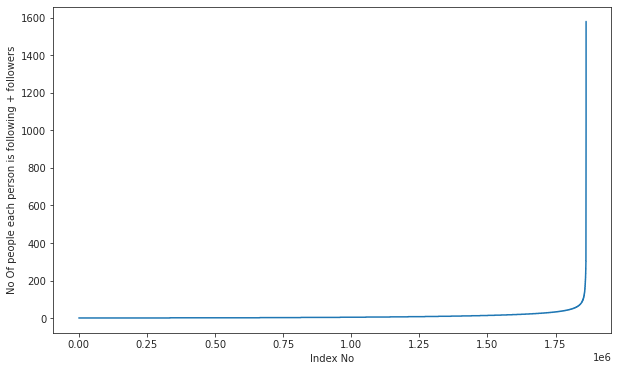

In [ ]:
in_out_degree_sort = sorted(in_out_degree)
plt.figure(figsize=(10,6))
plt.plot(in_out_degree_sort)
plt.xlabel('Index No')
plt.ylabel('No Of people each person is following + followers')
plt.show()

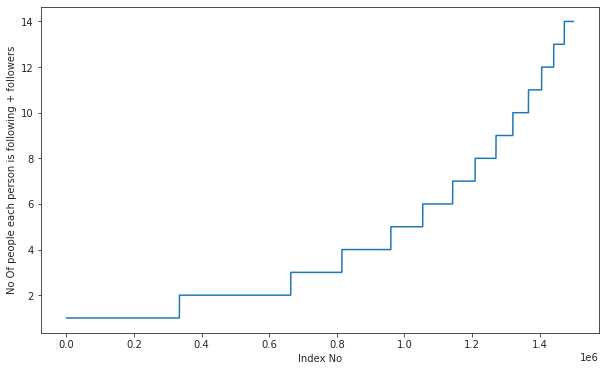

In [ ]:
in_out_degree_sort = sorted(in_out_degree)
plt.figure(figsize=(10,6))
plt.plot(in_out_degree_sort[0:1500000])
plt.xlabel('Index No')
plt.ylabel('No Of people each person is following + followers')
plt.show()

In [ ]:
### 90-100 percentile
for i in range(0,11):
    print(90+i,'percentile value is',np.percentile(in_out_degree_sort,90+i))

90 percentile value is 24.0
91 percentile value is 26.0
92 percentile value is 28.0
93 percentile value is 31.0
94 percentile value is 33.0
95 percentile value is 37.0
96 percentile value is 41.0
97 percentile value is 48.0
98 percentile value is 58.0
99 percentile value is 79.0
100 percentile value is 1579.0


In [ ]:
### 99-100 percentile
for i in range(10,110,10):
    print(99+(i/100),'percentile value is',np.percentile(in_out_degree_sort,99+(i/100)))

99.1 percentile value is 83.0
99.2 percentile value is 87.0
99.3 percentile value is 93.0
99.4 percentile value is 99.0
99.5 percentile value is 108.0
99.6 percentile value is 120.0
99.7 percentile value is 138.0
99.8 percentile value is 168.0
99.9 percentile value is 221.0
100.0 percentile value is 1579.0


min no of followers or following

total no of people displayed below

In [ ]:
print('Min of no of followers + following is',in_out_degree.min())
print(np.sum(in_out_degree==in_out_degree.min()),' persons having minimum no of followers + following')

Min of no of followers + following is 1
334291  persons having minimum no of followers + following


max no of followers and following

1579 that too for only one person

In [ ]:
print('Max of no of followers + following is',in_out_degree.max())
print(np.sum(in_out_degree==in_out_degree.max()),' persons having maximum no of followers + following')

Max of no of followers + following is 1579
1  persons having maximum no of followers + following


In [ ]:
print('No of persons having followers + following less than 10 are',np.sum(in_out_degree<10))

No of persons having followers + following less than 10 are 1320326


In [ ]:
# Gs = nx.DiGraph() # a directed graph
# Gs.add_edges_from([('A', 'B'), ('A', 'C'), ('D', 'B'),('B','A'),('C','A'),('D','A')])
# list(nx.weakly_connected_components(Gs))

[{'A', 'B', 'C', 'D'}]

In [ ]:
print('No of weakly connected components',len(list(nx.weakly_connected_components(g))))
count=0
for i in list(nx.weakly_connected_components(g)):
    if len(i)==2:
        count+=1
print('weakly connected components wit 2 nodes',count)

No of weakly connected components 45558
weakly connected components wit 2 nodes 32195


# 2. Posing a problem as classification problem 

## 2.1 Generating some edges which are not present in graph for supervised learning  
Generated Bad links from graph which are not in graph and whose shortest path is greater than 2. 

Below example for creating data which is not available

we take all edges and store in a dict

if edge present we give value else -1

if value = -1 and if nodes of edges are not same we take into consideration

next if shortest_path_length is greater than 2 we consider and add into missing edges

In [ ]:
# import random
# edges_s= dict()
# r_s = {(1,2),(1,4),(2,3),(2,5)}
# for edge in r_s:
#     edges_s[(edge[0], edge[1])] = 1
# print(edges_s)
# print(edges_s.get((2,4),-1))

# missing_edges_s = set([])
# while (len(missing_edges_s)<10):
#     a_s=random.randint(1, 6)
#     b_s=random.randint(1, 6)
#     tmp_s = edges_s.get((a_s,b_s),-1)
#     if tmp_s == -1 and a_s!=b_s:
#         try:
#             if nx.shortest_path_length(Gs,source=a_s,target=b_s) > 2: 
#                 missing_edges_s.add((a_s,b_s))
#             else:
#                 continue  
#         except:  
#                 missing_edges_s.add((a_s,b_s))              
#     else:
#         continue
# print(missing_edges_s)

{(1, 2): 1, (2, 5): 1, (2, 3): 1, (1, 4): 1}
-1
{(1, 3), (4, 6), (5, 6), (3, 1), (1, 6), (3, 6), (4, 3), (5, 1), (3, 4), (3, 5)}


shortest path example

In [ ]:
# import networkx as nx
# G_s=nx.Graph()
# G_s.add_nodes_from([1,2,3,4])
# G_s.add_edge(1,2)
# G_s.add_edge(1,3)
# G_s.add_edge(1,4)
# G_s.add_edge(4,1)
# G_s.add_edge(4,2)
# G_s.add_edge(3,2)
# G_s.add_edge(2,1)
# G_s.add_edge(3,4)
# try:
#     n_s=nx.shortest_path_length(G_s,2)
#     print(n_s)
# except nx.NetworkXNoPath:
#     print('No path')

{2: 0, 1: 1, 4: 1, 3: 1}


In [ ]:
%%time
###generating bad edges from given graph
# import random
# if not os.path.isfile('/content/drive/My Drive/AppliedAI-Practice/Facebook/data/after_eda/missing_edges_final.p'):
#     #getting all set of edges
#     r = csv.reader(open('/content/drive/My Drive/AppliedAI-Practice/Facebook/data/after_eda/train_woheader.csv','r'))
#     edges = dict()
#     for edge in r:
#         edges[(edge[0], edge[1])] = 1
        
        
#     missing_edges = set([])
#     while (len(missing_edges)<9437519):
#         a=random.randint(1, 1862220)
#         b=random.randint(1, 1862220)
#         tmp = edges.get((a,b),-1)
#         if tmp == -1 and a!=b:
#             try:
#                 if nx.shortest_path_length(g,source=a,target=b) > 2: 

#                     missing_edges.add((a,b))
#                 else:
#                     continue  
#             except:  
#                     missing_edges.add((a,b))              
#         else:
#             continue
#     pickle.dump(missing_edges,open('/content/drive/My Drive/AppliedAI-Practice/Facebook/data/after_eda/missing_edges_final.p','wb'))
# else:
missing_edges = pickle.load(open('/content/drive/My Drive/AppliedAI-Practice/Facebook/data/after_eda/missing_edges_final.p','rb'))

CPU times: user 1.95 s, sys: 1.09 s, total: 3.04 s
Wall time: 5.4 s


In [ ]:
len(missing_edges)

9437519

## 2.2 Training and Test data split:  
Removed edges from Graph and used as test data and after removing used that graph for creating features for Train and test data

POs is those which have edges

Neg is missing edges 

We are dividing them into train and test 

In [ ]:
from sklearn.model_selection import train_test_split

df_pos = pd.read_csv('/content/drive/My Drive/AppliedAI-Practice/Facebook/data/train.csv')
df_neg = pd.DataFrame(list(missing_edges), columns=['source_node', 'destination_node'])
    
print("Number of nodes in the graph with edges", df_pos.shape[0])
print("Number of nodes in the graph without edges", df_neg.shape[0])

X_train_pos, X_test_pos, y_train_pos, y_test_pos  = train_test_split(df_pos,np.ones(len(df_pos)),test_size=0.2, random_state=9)
X_train_neg, X_test_neg, y_train_neg, y_test_neg  = train_test_split(df_neg,np.zeros(len(df_neg)),test_size=0.2, random_state=9)
    
print('='*60)
print("Number of nodes in the train data graph with edges", X_train_pos.shape[0],"=",y_train_pos.shape[0])
print("Number of nodes in the train data graph without edges", X_train_neg.shape[0],"=", y_train_neg.shape[0])
print('='*60)
print("Number of nodes in the test data graph with edges", X_test_pos.shape[0],"=",y_test_pos.shape[0])
print("Number of nodes in the test data graph without edges", X_test_neg.shape[0],"=",y_test_neg.shape[0])

del missing_edges

Number of nodes in the graph with edges 9437519
Number of nodes in the graph without edges 9437519
Number of nodes in the train data graph with edges 7550015 = 7550015
Number of nodes in the train data graph without edges 7550015 = 7550015
Number of nodes in the test data graph with edges 1887504 = 1887504
Number of nodes in the test data graph without edges 1887504 = 1887504


getting positive nodes from train and test

In [ ]:
train_graph=nx.read_edgelist('/content/drive/My Drive/AppliedAI-Practice/Facebook/data/after_eda/train_pos_after_eda.csv',delimiter=',',create_using=nx.DiGraph(),nodetype=int)
test_graph=nx.read_edgelist('/content/drive/My Drive/AppliedAI-Practice/Facebook/data/after_eda/test_pos_after_eda.csv',delimiter=',',create_using=nx.DiGraph(),nodetype=int)
print(nx.info(train_graph))
print(nx.info(test_graph))

train_nodes_pos = set(train_graph.nodes())
test_nodes_pos = set(test_graph.nodes())

trY_teY = len(train_nodes_pos.intersection(test_nodes_pos))
trY_teN = len(train_nodes_pos - test_nodes_pos)
teY_trN = len(test_nodes_pos - train_nodes_pos)

print('no of people common in train and test -- ',trY_teY)
print('no of people present in train but not present in test -- ',trY_teN)

print('no of people present in test but not present in train -- ',teY_trN)
print(' % of people not there in Train but exist in Test in total Test data are {} %'.format(teY_trN/len(test_nodes_pos)*100))

Name: 
Type: DiGraph
Number of nodes: 1780722
Number of edges: 7550015
Average in degree:   4.2399
Average out degree:   4.2399
Name: 
Type: DiGraph
Number of nodes: 1144623
Number of edges: 1887504
Average in degree:   1.6490
Average out degree:   1.6490
no of people common in train and test --  1063125
no of people present in train but not present in test --  717597
no of people present in test but not present in train --  81498
 % of people not there in Train but exist in Test in total Test data are 7.1200735962845405 %


> we have a cold start problem here

In [ ]:
    
X_train_pos = pd.read_csv('/content/drive/My Drive/AppliedAI-Practice/Facebook/data/after_eda/train_pos_after_eda.csv', names=['source_node', 'destination_node'])
X_test_pos = pd.read_csv('/content/drive/My Drive/AppliedAI-Practice/Facebook/data/after_eda/test_pos_after_eda.csv', names=['source_node', 'destination_node'])
X_train_neg = pd.read_csv('/content/drive/My Drive/AppliedAI-Practice/Facebook/data/after_eda/train_neg_after_eda.csv', names=['source_node', 'destination_node'])
X_test_neg = pd.read_csv('/content/drive/My Drive/AppliedAI-Practice/Facebook/data/after_eda/test_neg_after_eda.csv', names=['source_node', 'destination_node'])


In [ ]:

print('='*60)
print("Number of nodes in the train data graph with edges", X_train_pos.shape[0])
print("Number of nodes in the train data graph without edges", X_train_neg.shape[0])
print('='*60)
print("Number of nodes in the test data graph with edges", X_test_pos.shape[0])
print("Number of nodes in the test data graph without edges", X_test_neg.shape[0])

X_train = X_train_pos.append(X_train_neg,ignore_index=True)
y_train = np.concatenate((y_train_pos,y_train_neg))
X_test = X_test_pos.append(X_test_neg,ignore_index=True)
y_test = np.concatenate((y_test_pos,y_test_neg)) 

print("Data points in train data",X_train.shape)
print("Data points in test data",X_test.shape)
print("Shape of traget variable in train",y_train.shape)
print("Shape of traget variable in test", y_test.shape)

Number of nodes in the train data graph with edges 7550015
Number of nodes in the train data graph without edges 7550015
Number of nodes in the test data graph with edges 1887504
Number of nodes in the test data graph without edges 1887504
Data points in train data (15100030, 2)
Data points in test data (3775008, 2)
Shape of traget variable in train (15100030,)
Shape of traget variable in test (3775008,)


  Info of Train Graph

In [ ]:
print(nx.info(train_graph))

Name: 
Type: DiGraph
Number of nodes: 1780722
Number of edges: 7550015
Average in degree:   4.2399
Average out degree:   4.2399


In [ ]:
def jaccard_for_followees(a,b):
    try:
        if len(set(train_graph.successors(a))) == 0  | len(set(train_graph.successors(b))) == 0:
            return 0
        sim = (len(set(train_graph.successors(a)).intersection(set(train_graph.successors(b)))))/\
                                    (len(set(train_graph.successors(a)).union(set(train_graph.successors(b)))))
    except:
        return 0
    return sim

so succesoors meansthose who are folowees of x

Jaccard means that intersection of both /  union of all

here number of intersection of followers between a & b /  number of total a and b

X inters Y / X U Y

Predecessors means followers example us  for "alia bhat "  we are followes

successors means followees example alia bhat is followee

In [ ]:
# def jaccard_for_followersG_s(a,b):
#     try:
#         if len(set(G_s.predecessors(a))) == 0  | len(set(G_s.predecessors(b))) == 0:
#             return 0
#         sim = (len(set(G_s.predecessors(a)).intersection(set(G_s.predecessors(b)))))/\
#                                  (len(set(G_s.predecessors(a)).union(set(G_s.predecessors(b)))))
#         return sim
#     except:
#         return 0

In [ ]:
# G_s=nx.DiGraph()
# G_s.add_nodes_from([1,2,3,4])
# G_s.add_edge(1,2)
# G_s.add_edge(1,3)
# G_s.add_edge(1,4)
# G_s.add_edge(4,1)
# G_s.add_edge(4,2)
# G_s.add_edge(3,2)
# G_s.add_edge(2,1)
# G_s.add_edge(3,4)
# print(list(G_s.predecessors(2)))
# print(list(G_s.predecessors(3)))
# jaccard_for_followersG_s(2,3)

In [ ]:
print(jaccard_for_followees(273084,1505602))

0.0


In [ ]:
print(jaccard_for_followees(1,234555))

0.0


In [ ]:
def jaccard_for_followers(a,b):
    try:
        if len(set(train_graph.predecessors(a))) == 0  | len(set(train_graph.predecessors(b))) == 0:
            return 0
        sim = (len(set(train_graph.predecessors(a)).intersection(set(train_graph.predecessors(b)))))/\
                                 (len(set(train_graph.predecessors(a)).union(set(train_graph.predecessors(b)))))
    except:
        return 0
    return sim

In [ ]:
print(jaccard_for_followers(273084,470294))

0.0


Cosine Similarity

this is simple   ||X . INTERSECTION  Y||
                                        /
                                        SQRT(|x| * |Y|)

In [ ]:
def cosine_for_followees(a,b):
    try:
        if len(set(train_graph.successors(a))) == 0  | len(set(train_graph.successors(b))) == 0:
            return 0
        sim = (len(set(train_graph.successors(a)).intersection(set(train_graph.successors(b)))))/\
                                    (math.sqrt(len(set(train_graph.successors(a)))*len((set(train_graph.successors(b))))))
        return sim
    except:
        return 0

In [ ]:
def cosine_for_followers(a,b):
    try:
        
        if len(set(train_graph.predecessors(a))) == 0  | len(set(train_graph.predecessors(b))) == 0:
            return 0
        sim = (len(set(train_graph.predecessors(a)).intersection(set(train_graph.predecessors(b)))))/\
                                     (math.sqrt(len(set(train_graph.predecessors(a))))*(len(set(train_graph.predecessors(b)))))
        return sim
    except:
        return 0

In [ ]:
print(cosine_for_followers(2,40000))

0.0


Page Rank

Page rank is mostly used in search engines

Like if we get reference link from google it has higher importance than other links



Will give probability of importance example people following alia bhat have higher prob when compared to normal people

In [ ]:
pr = pickle.load(open('/content/drive/My Drive/AppliedAI-Practice/Facebook/data/fea_sample/page_rank.p','rb'))

In [ ]:
print('min',pr[min(pr, key=pr.get)])
print('max',pr[max(pr, key=pr.get)])
print('mean',float(sum(pr.values())) / len(pr))

min 1.6556497245737814e-07
max 2.7098251341935827e-05
mean 5.615699699389075e-07


In [ ]:
mean_pr = float(sum(pr.values())) / len(pr)
print(mean_pr)

5.615699699389075e-07


Shortest path 

Caluculate shortest path which is just like mutual friends

We are removing the edge betwwen them and calculating shortest path if any

Why remove?-- If we not remove the dist will be 1 no value

In [ ]:
def compute_shortest_path_length(a,b):
    p=-1
    try:
        if train_graph.has_edge(a,b):
            train_graph.remove_edge(a,b)
            p= nx.shortest_path_length(train_graph,source=a,target=b)
            train_graph.add_edge(a,b)
        else:
            p= nx.shortest_path_length(train_graph,source=a,target=b)
        return p
    except:
        return -1

In [ ]:
#testing
compute_shortest_path_length(77697, 826021)

10

Weakly connected components

Weakly connected components are those who do not have any directions

This gives us a group of people

Example you have one group school friends and other office colleagues

If All are different then it considers as two groups

Even if there is one edge between the two groups it will be considered as 1 group

Helps in differentiating

This helps us not to map fans of celebrety to other fan who doesnot even have relation

In [ ]:
#getting weekly connected edges from graph 
wcc=list(nx.weakly_connected_components(train_graph))
def belongs_to_same_wcc(a,b):
    index = []
    if train_graph.has_edge(b,a):
        return 1
    if train_graph.has_edge(a,b):
            for i in wcc:
                if a in i:
                    index= i
                    break
            if (b in index):
                train_graph.remove_edge(a,b)
                if compute_shortest_path_length(a,b)==-1:
                    train_graph.add_edge(a,b)
                    return 0
                else:
                    train_graph.add_edge(a,b)
                    return 1
            else:
                return 0
    else:
            for i in wcc:
                if a in i:
                    index= i
                    break
            if(b in index):
                return 1
            else:
                return 0

In [ ]:
belongs_to_same_wcc(861, 1659750)

0

Adar Index

Let a and b a-- normal people

b -- alia bhatt

if x and y follow both a &b

Adar index sees neighbourhood

neighbourhood of alia bhatt is more than a

This implies that alia bhat fans should not get recommendations as they have lower chance

Instead X and Y should get recommendations due to friends of a .

So Adar Index tells recommendations by seeing neighbourhood

In [ ]:
#adar index
def calc_adar_in(a,b):
    sum=0
    try:
        n=list(set(train_graph.successors(a)).intersection(set(train_graph.successors(b))))
        if len(n)!=0:
            for i in n:
                sum=sum+(1/np.log10(len(list(train_graph.predecessors(i)))))
            return sum
        else:
            return 0
    except:
        return 0

In [ ]:
calc_adar_in(1,189226)

0

In [ ]:
def follows_back(a,b):
    if train_graph.has_edge(b,a):
        return 1
    else:
        return 0

Kartz Centrality

This gives mosly linkage

Example firms that tackle client and services

In [ ]:
# katz = nx.katz.katz_centrality(train_graph,alpha=0.005,beta=1)

In [ ]:
katz = pickle.load(open('/content/drive/My Drive/AppliedAI-Practice/Facebook/data/fea_sample/katz.p','rb'))

In [ ]:
print('min',katz[min(katz, key=katz.get)])
print('max',katz[max(katz, key=katz.get)])
print('mean',float(sum(katz.values())) / len(katz))

min 0.0007313532484065916
max 0.003394554981699122
mean 0.0007483800935562018


Hits score

Through Incoming links and ougoing links estimates Recommendations

In [ ]:
# hits = nx.hits(train_graph, max_iter=100, tol=1e-08, nstart=None, normalized=True)

In [ ]:
hits = pickle.load(open('/content/drive/My Drive/AppliedAI-Practice/Facebook/data/fea_sample/hits.p','rb'))

In [ ]:
print('min',hits[0][min(hits[0], key=hits[0].get)])
print('max',hits[0][max(hits[0], key=hits[0].get)])
print('mean',float(sum(hits[0].values())) / len(hits[0]))

min 0.0
max 0.004868653378780953
mean 5.615699699344123e-07


SVD

Just like Matrix Factorization

Here A will have all user data

In [ ]:
def svd(x, S):
    try:
        z = sadj_dict[x]
        return S[z]
    except:
        return [0,0,0,0,0,0]

In [ ]:
sadj_col = sorted(train_graph.nodes())
sadj_dict = { val:idx for idx,val in enumerate(sadj_col)}

In [ ]:
Adj = nx.adjacency_matrix(train_graph,nodelist=sorted(train_graph.nodes())).asfptype()

In [ ]:
from scipy.sparse import csc_matrix
from scipy.sparse.linalg import svds, eigs

In [ ]:
U, s, V = svds(Adj, k = 6)
print('Adjacency matrix Shape',Adj.shape)
print('U Shape',U.shape)
print('V Shape',V.shape)
print('s Shape',s.shape)

Adjacency matrix Shape (1780722, 1780722)
U Shape (1780722, 6)
V Shape (6, 1780722)
s Shape (6,)


weight features

We will remove some data from train and test as it is large

In [ ]:
import random
n_train =  15500000
s = 100000 #desired sample size
skip_train = sorted(random.sample(range(1,n_train+1),n_train-s))

In [ ]:
n_test = 3785000
s = 50000 #desired sample size
skip_test = sorted(random.sample(range(1,n_test+1),n_test-s))

In [ ]:
print("Number of rows in the train data file:", n_train)
print("Number of rows we are going to elimiate in train data are",len(skip_train))
print("Number of rows in the test data file:", n_test)
print("Number of rows we are going to elimiate in test data are",len(skip_test))

Number of rows in the train data file: 15500000
Number of rows we are going to elimiate in train data are 15400000
Number of rows in the test data file: 3785000
Number of rows we are going to elimiate in test data are 3735000


In [ ]:
df_final_train = pd.read_csv('/content/drive/My Drive/AppliedAI-Practice/Facebook/data/after_eda/train_after_eda.csv', skiprows=skip_train, names=['source_node', 'destination_node'])
df_final_train['indicator_link'] = pd.read_csv('/content/drive/My Drive/AppliedAI-Practice/Facebook/data/train_y.csv', skiprows=skip_train, names=['indicator_link'])
print("Our train matrix size ",df_final_train.shape)
df_final_train.head(2)

Our train matrix size  (97446, 3)


,source_node,destination_node,indicator_link
0,273084,1505602,1
1,65493,26839,1


In [ ]:
df_final_test = pd.read_csv('/content/drive/My Drive/AppliedAI-Practice/Facebook/data/after_eda/test_after_eda.csv', skiprows=skip_test, names=['source_node', 'destination_node'])
df_final_test['indicator_link'] = pd.read_csv('/content/drive/My Drive/AppliedAI-Practice/Facebook/data/test_y.csv', skiprows=skip_test, names=['indicator_link'])
print("Our test matrix size ",df_final_test.shape)
df_final_test.head(2)

Our test matrix size  (49868, 3)


,source_node,destination_node,indicator_link
0,848424,784690,1
1,1282653,659527,1


In [ ]:
def compute_features_stage1(df_final):
    #calculating no of followers followees for source and destination
    #calculating intersection of followers and followees for source and destination
    num_followers_s=[]
    num_followees_s=[]
    num_followers_d=[]
    num_followees_d=[]
    inter_followers=[]
    inter_followees=[]
    for i,row in df_final.iterrows():
        try:
            s1=set(train_graph.predecessors(row['source_node']))
            s2=set(train_graph.successors(row['source_node']))
        except:
            s1 = set()
            s2 = set()
        try:
            d1=set(train_graph.predecessors(row['destination_node']))
            d2=set(train_graph.successors(row['destination_node']))
        except:
            d1 = set()
            d2 = set()
        num_followers_s.append(len(s1))
        num_followees_s.append(len(s2))

        num_followers_d.append(len(d1))
        num_followees_d.append(len(d2))

        inter_followers.append(len(s1.intersection(d1)))
        inter_followees.append(len(s2.intersection(d2)))
    
    return num_followers_s, num_followers_d, num_followees_s, num_followees_d, inter_followers, inter_followees

In [ ]:
mean_katz = float(sum(katz.values())) / len(katz)
print(mean_katz)

0.0007483800935562018


In [ ]:
df_final_train['jaccard_followers'] = df_final_train.apply(lambda row:
                                            jaccard_for_followers(row['source_node'],row['destination_node']),axis=1)
df_final_train['jaccard_followees'] = df_final_train.apply(lambda row:
                                            jaccard_for_followers(row['source_node'],row['destination_node']),axis=1)
df_final_train['cosine_followers'] = df_final_train.apply(lambda row:
                                            cosine_for_followers(row['source_node'],row['destination_node']),axis=1)
df_final_train['cosine_for_followees'] = df_final_train.apply(lambda row:
                                            cosine_for_followers(row['source_node'],row['destination_node']),axis=1)
df_final_train['adar_index'] = df_final_train.apply(lambda row:
                                            calc_adar_in(row['source_node'],row['destination_node']),axis=1)
df_final_train['follows_back'] = df_final_train.apply(lambda row:
                                            follows_back(row['source_node'],row['destination_node']),axis=1)
df_final_train['same_comp'] = df_final_train.apply(lambda row:
                                            belongs_to_same_wcc(row['source_node'],row['destination_node']),axis=1)
df_final_train['shortest_path'] = df_final_train.apply(lambda row:
                                            compute_shortest_path_length(row['source_node'],row['destination_node']),axis=1)
df_final_train['page_rank_s'] = df_final_train.source_node.apply(lambda x:pr.get(x,mean_pr))

df_final_train['page_rank_d'] = df_final_train.destination_node.apply(lambda x:pr.get(x,mean_pr))

df_final_train['katz_s'] = df_final_train.source_node.apply(lambda x: katz.get(x,mean_katz))

df_final_train['katz_d'] = df_final_train.destination_node.apply(lambda x: katz.get(x,mean_katz))

df_final_train['hubs_s'] = df_final_train.source_node.apply(lambda x: hits[0].get(x,0))

df_final_train['hubs_d'] = df_final_train.destination_node.apply(lambda x: hits[0].get(x,0))

df_final_train['authorities_s'] = df_final_train.source_node.apply(lambda x: hits[1].get(x,0))

df_final_train['authorities_d'] = df_final_train.destination_node.apply(lambda x: hits[1].get(x,0))

df_final_train['num_followers_s'], df_final_train['num_followers_d'], \
df_final_train['num_followees_s'], df_final_train['num_followees_d'], \
df_final_train['inter_followers'], df_final_train['inter_followees']= compute_features_stage1(df_final_train)


In [ ]:
df_final_test['jaccard_followers'] = df_final_test.apply(lambda row:
                                            jaccard_for_followers(row['source_node'],row['destination_node']),axis=1)

df_final_test['jaccard_followees'] = df_final_test.apply(lambda row:
                                            jaccard_for_followers(row['source_node'],row['destination_node']),axis=1)

df_final_test['cosine_followers'] = df_final_test.apply(lambda row:
                                            cosine_for_followers(row['source_node'],row['destination_node']),axis=1)

df_final_test['cosine_for_followees'] = df_final_test.apply(lambda row:
                                            cosine_for_followers(row['source_node'],row['destination_node']),axis=1)

df_final_test['adar_index'] = df_final_test.apply(lambda row: calc_adar_in(row['source_node'],row['destination_node']),axis=1)

df_final_test['follows_back'] = df_final_test.apply(lambda row: follows_back(row['source_node'],row['destination_node']),axis=1)

df_final_test['same_comp'] = df_final_test.apply(lambda row: belongs_to_same_wcc(row['source_node'],row['destination_node']),axis=1)

df_final_test['shortest_path'] = df_final_test.apply(lambda row: compute_shortest_path_length(row['source_node'],row['destination_node']),axis=1)

df_final_test['page_rank_s'] = df_final_test.source_node.apply(lambda x:pr.get(x,mean_pr))

df_final_test['page_rank_d'] = df_final_test.destination_node.apply(lambda x:pr.get(x,mean_pr))

df_final_test['katz_s'] = df_final_test.source_node.apply(lambda x: katz.get(x,mean_katz))

df_final_test['katz_d'] = df_final_test.destination_node.apply(lambda x: katz.get(x,mean_katz))

df_final_test['hubs_s'] = df_final_test.source_node.apply(lambda x: hits[0].get(x,0))

df_final_test['hubs_d'] = df_final_test.destination_node.apply(lambda x: hits[0].get(x,0))

df_final_test['authorities_s'] = df_final_test.source_node.apply(lambda x: hits[1].get(x,0))

df_final_test['authorities_d'] = df_final_test.destination_node.apply(lambda x: hits[1].get(x,0))

df_final_test['num_followers_s'], df_final_test['num_followers_d'], \
df_final_test['num_followees_s'], df_final_test['num_followees_d'], \
df_final_test['inter_followers'], df_final_test['inter_followees']= compute_features_stage1(df_final_test)

In [ ]:
df_final_train[['svd_u_s_1', 'svd_u_s_2','svd_u_s_3', 'svd_u_s_4', 'svd_u_s_5', 'svd_u_s_6']] = \
df_final_train.source_node.apply(lambda x: svd(x, U)).apply(pd.Series)

df_final_train[['svd_u_d_1', 'svd_u_d_2', 'svd_u_d_3', 'svd_u_d_4', 'svd_u_d_5','svd_u_d_6']] = \
df_final_train.destination_node.apply(lambda x: svd(x, U)).apply(pd.Series)
#===================================================================================================

df_final_train[['svd_v_s_1','svd_v_s_2', 'svd_v_s_3', 'svd_v_s_4', 'svd_v_s_5', 'svd_v_s_6',]] = \
df_final_train.source_node.apply(lambda x: svd(x, V.T)).apply(pd.Series)

df_final_train[['svd_v_d_1', 'svd_v_d_2', 'svd_v_d_3', 'svd_v_d_4', 'svd_v_d_5','svd_v_d_6']] = \
df_final_train.destination_node.apply(lambda x: svd(x, V.T)).apply(pd.Series)
#===================================================================================================

df_final_test[['svd_u_s_1', 'svd_u_s_2','svd_u_s_3', 'svd_u_s_4', 'svd_u_s_5', 'svd_u_s_6']] = \
df_final_test.source_node.apply(lambda x: svd(x, U)).apply(pd.Series)

df_final_test[['svd_u_d_1', 'svd_u_d_2', 'svd_u_d_3', 'svd_u_d_4', 'svd_u_d_5','svd_u_d_6']] = \
df_final_test.destination_node.apply(lambda x: svd(x, U)).apply(pd.Series)

#===================================================================================================

df_final_test[['svd_v_s_1','svd_v_s_2', 'svd_v_s_3', 'svd_v_s_4', 'svd_v_s_5', 'svd_v_s_6',]] = \
df_final_test.source_node.apply(lambda x: svd(x, V.T)).apply(pd.Series)

df_final_test[['svd_v_d_1', 'svd_v_d_2', 'svd_v_d_3', 'svd_v_d_4', 'svd_v_d_5','svd_v_d_6']] = \
df_final_test.destination_node.apply(lambda x: svd(x, V.T)).apply(pd.Series)

In [ ]:
from tqdm import tqdm 
Weight_in = {}
Weight_out = {}
for i in  tqdm(train_graph.nodes()):
    s1=set(train_graph.predecessors(i))
    w_in = 1.0/(np.sqrt(1+len(s1)))
    Weight_in[i]=w_in
    
    s2=set(train_graph.successors(i))
    w_out = 1.0/(np.sqrt(1+len(s2)))
    Weight_out[i]=w_out
    
#for imputing with mean
mean_weight_in = np.mean(list(Weight_in.values()))
mean_weight_out = np.mean(list(Weight_out.values()))

100%|██████████| 1780722/1780722 [00:18<00:00, 96200.62it/s] 


In [ ]:
df_final_train['weight_in'] = df_final_train.destination_node.apply(lambda x: Weight_in.get(x,mean_weight_in))
df_final_train['weight_out'] = df_final_train.source_node.apply(lambda x: Weight_out.get(x,mean_weight_out))

#mapping to pandas test
df_final_test['weight_in'] = df_final_test.destination_node.apply(lambda x: Weight_in.get(x,mean_weight_in))
df_final_test['weight_out'] = df_final_test.source_node.apply(lambda x: Weight_out.get(x,mean_weight_out))


#some features engineerings on the in and out weights
df_final_train['weight_f1'] = df_final_train.weight_in + df_final_train.weight_out
df_final_train['weight_f2'] = df_final_train.weight_in * df_final_train.weight_out
df_final_train['weight_f3'] = (2*df_final_train.weight_in + 1*df_final_train.weight_out)
df_final_train['weight_f4'] = (1*df_final_train.weight_in + 2*df_final_train.weight_out)

#some features engineerings on the in and out weights
df_final_test['weight_f1'] = df_final_test.weight_in + df_final_test.weight_out
df_final_test['weight_f2'] = df_final_test.weight_in * df_final_test.weight_out
df_final_test['weight_f3'] = (2*df_final_test.weight_in + 1*df_final_test.weight_out)
df_final_test['weight_f4'] = (1*df_final_test.weight_in + 2*df_final_test.weight_out)

In [ ]:
def dot_product(a,b):
  return np.dot(a,b)

In [ ]:
df_final_train.head()

,source_node,destination_node,indicator_link,jaccard_followers,jaccard_followees,cosine_followers,cosine_for_followees,adar_index,follows_back,same_comp,shortest_path,page_rank_s,page_rank_d,katz_s,katz_d,hubs_s,hubs_d,authorities_s,authorities_d,num_followers_s,num_followers_d,num_followees_s,num_followees_d,inter_followers,inter_followees,svd_u_s_1,svd_u_s_2,svd_u_s_3,svd_u_s_4,svd_u_s_5,svd_u_s_6,svd_u_d_1,svd_u_d_2,svd_u_d_3,svd_u_d_4,svd_u_d_5,svd_u_d_6,svd_v_s_1,svd_v_s_2,svd_v_s_3,svd_v_s_4,svd_v_s_5,svd_v_s_6,svd_v_d_1,svd_v_d_2,svd_v_d_3,svd_v_d_4,svd_v_d_5,svd_v_d_6,weight_in,weight_out,weight_f1,weight_f2,weight_f3,weight_f4
0,273084,1505602,1,0.000000,0.000000,0.000000,0.000000,0.000000,0,1,4,2.045290e-06,3.459963e-07,0.000773,0.000756,1.943132e-13,1.941103e-13,9.226339e-16,2.231877e-15,11,6,15,8,0,0,-1.666334e-13,4.613820e-13,1.043041e-05,6.678033e-13,2.451105e-13,3.584945e-12,-2.038018e-11,5.397910e-13,1.068943e-06,1.192461e-12,2.279488e-12,3.581202e-12,-7.216151e-13,3.926263e-13,1.983700e-06,1.545089e-13,8.108438e-13,1.719704e-14,-1.355369e-12,4.675320e-13,1.128586e-06,6.616718e-14,9.771079e-13,4.160011e-14,0.377964,0.250000,0.627964,0.094491,1.005929,0.877964
1,65493,26839,1,0.047619,0.047619,0.033408,0.033408,0.000000,0,1,2,7.948263e-07,4.225280e-07,0.000787,0.000763,1.066722e-16,0.000000e+00,2.142186e-15,1.679764e-17,14,8,19,0,1,0,-1.032834e-11,5.838997e-11,1.376282e-10,7.551194e-12,4.661321e-12,1.968019e-15,4.702569e-20,-1.820266e-20,9.629697e-20,-2.107715e-20,1.944094e-19,1.734756e-19,-2.093337e-12,2.498523e-11,1.277375e-10,3.237806e-12,9.174217e-12,3.992837e-14,-3.110057e-13,3.887223e-10,7.802583e-12,1.590925e-13,7.475797e-13,3.130949e-16,0.333333,0.223607,0.556940,0.074536,0.890273,0.780547
2,1787589,1271866,1,0.500000,0.500000,0.300000,0.300000,2.290604,1,1,2,3.885550e-07,5.476665e-07,0.000747,0.000750,1.239786e-17,5.326670e-18,8.030284e-18,8.132367e-18,4,5,5,5,3,2,-1.369431e-14,3.648056e-14,3.439658e-13,4.308144e-15,3.559761e-14,2.286001e-16,-8.195559e-15,1.306680e-15,7.348743e-14,4.479410e-15,1.151677e-15,9.841274e-17,-8.965566e-14,5.615407e-15,1.019265e-12,5.741304e-14,1.681971e-14,1.496811e-16,-8.981314e-14,6.318689e-15,1.214372e-12,5.743639e-14,1.737433e-14,1.515833e-16,0.408248,0.408248,0.816497,0.166667,1.224745,1.224745
3,461372,254064,1,0.000000,0.000000,0.000000,0.000000,0.000000,1,1,5,3.225305e-06,2.226579e-07,0.000907,0.000740,3.957979e-14,1.170267e-15,1.626837e-13,2.786735e-16,45,2,51,2,0,0,-9.083097e-11,1.243604e-07,1.087758e-07,1.716833e-11,1.717997e-09,7.302190e-13,-1.012693e-11,1.013239e-09,3.022196e-10,2.071891e-13,9.576635e-12,2.159047e-14,-9.991070e-10,1.001519e-07,3.102890e-08,2.103554e-11,1.197418e-09,3.032274e-12,-9.205936e-13,1.239368e-09,1.056017e-09,1.663949e-13,1.373029e-11,5.194209e-15,0.577350,0.138675,0.716025,0.080064,1.293376,0.854700
4,1226940,1779696,1,0.051724,0.051724,0.035714,0.035714,1.375627,0,1,2,3.489225e-06,1.457843e-06,0.000931,0.000779,8.464703e-13,2.437080e-13,1.203491e-12,9.242559e-15,49,12,93,17,3,2,-4.800163e-10,1.313714e-09,3.099196e-05,4.094756e-10,3.319662e-09,1.561679e-11,-9.269675e-11,5.175625e-11,9.306267e-09,5.511749e-12,9.749185e-10,4.496244e-12,-1.040723e-09,2.848680e-10,6.230235e-05,9.405142e-11,1.277081e-09,2.243196e-11,-1.211895e-11,4.865610e-11,3.202602e-07,7.610075e-12,4.236400e-11,1.722728e-13,0.277350,0.103142,0.380492,0.028606,0.657842,0.483634


In [ ]:
df_final_train.head()

,source_node,destination_node,indicator_link,jaccard_followers,jaccard_followees,cosine_followers,cosine_for_followees,adar_index,follows_back,same_comp,shortest_path,page_rank_s,page_rank_d,katz_s,katz_d,hubs_s,hubs_d,authorities_s,authorities_d,num_followers_s,num_followers_d,num_followees_s,num_followees_d,inter_followers,inter_followees,svd_u_s_1,svd_u_s_2,svd_u_s_3,svd_u_s_4,svd_u_s_5,svd_u_s_6,svd_u_d_1,svd_u_d_2,svd_u_d_3,svd_u_d_4,svd_u_d_5,svd_u_d_6,svd_v_s_1,svd_v_s_2,svd_v_s_3,svd_v_s_4,svd_v_s_5,svd_v_s_6,svd_v_d_1,svd_v_d_2,svd_v_d_3,svd_v_d_4,svd_v_d_5,svd_v_d_6,weight_in,weight_out,weight_f1,weight_f2,weight_f3,weight_f4
0,273084,1505602,1,0.000000,0.000000,0.000000,0.000000,0.000000,0,1,4,2.045290e-06,3.459963e-07,0.000773,0.000756,1.943132e-13,1.941103e-13,9.226339e-16,2.231877e-15,11,6,15,8,0,0,-1.666334e-13,4.613820e-13,1.043041e-05,6.678033e-13,2.451105e-13,3.584945e-12,-2.038018e-11,5.397910e-13,1.068943e-06,1.192461e-12,2.279488e-12,3.581202e-12,-7.216151e-13,3.926263e-13,1.983700e-06,1.545089e-13,8.108438e-13,1.719704e-14,-1.355369e-12,4.675320e-13,1.128586e-06,6.616718e-14,9.771079e-13,4.160011e-14,0.377964,0.250000,0.627964,0.094491,1.005929,0.877964
1,65493,26839,1,0.047619,0.047619,0.033408,0.033408,0.000000,0,1,2,7.948263e-07,4.225280e-07,0.000787,0.000763,1.066722e-16,0.000000e+00,2.142186e-15,1.679764e-17,14,8,19,0,1,0,-1.032834e-11,5.838997e-11,1.376282e-10,7.551194e-12,4.661321e-12,1.968019e-15,4.702569e-20,-1.820266e-20,9.629697e-20,-2.107715e-20,1.944094e-19,1.734756e-19,-2.093337e-12,2.498523e-11,1.277375e-10,3.237806e-12,9.174217e-12,3.992837e-14,-3.110057e-13,3.887223e-10,7.802583e-12,1.590925e-13,7.475797e-13,3.130949e-16,0.333333,0.223607,0.556940,0.074536,0.890273,0.780547
2,1787589,1271866,1,0.500000,0.500000,0.300000,0.300000,2.290604,1,1,2,3.885550e-07,5.476665e-07,0.000747,0.000750,1.239786e-17,5.326670e-18,8.030284e-18,8.132367e-18,4,5,5,5,3,2,-1.369431e-14,3.648056e-14,3.439658e-13,4.308144e-15,3.559761e-14,2.286001e-16,-8.195559e-15,1.306680e-15,7.348743e-14,4.479410e-15,1.151677e-15,9.841274e-17,-8.965566e-14,5.615407e-15,1.019265e-12,5.741304e-14,1.681971e-14,1.496811e-16,-8.981314e-14,6.318689e-15,1.214372e-12,5.743639e-14,1.737433e-14,1.515833e-16,0.408248,0.408248,0.816497,0.166667,1.224745,1.224745
3,461372,254064,1,0.000000,0.000000,0.000000,0.000000,0.000000,1,1,5,3.225305e-06,2.226579e-07,0.000907,0.000740,3.957979e-14,1.170267e-15,1.626837e-13,2.786735e-16,45,2,51,2,0,0,-9.083097e-11,1.243604e-07,1.087758e-07,1.716833e-11,1.717997e-09,7.302190e-13,-1.012693e-11,1.013239e-09,3.022196e-10,2.071891e-13,9.576635e-12,2.159047e-14,-9.991070e-10,1.001519e-07,3.102890e-08,2.103554e-11,1.197418e-09,3.032274e-12,-9.205936e-13,1.239368e-09,1.056017e-09,1.663949e-13,1.373029e-11,5.194209e-15,0.577350,0.138675,0.716025,0.080064,1.293376,0.854700
4,1226940,1779696,1,0.051724,0.051724,0.035714,0.035714,1.375627,0,1,2,3.489225e-06,1.457843e-06,0.000931,0.000779,8.464703e-13,2.437080e-13,1.203491e-12,9.242559e-15,49,12,93,17,3,2,-4.800163e-10,1.313714e-09,3.099196e-05,4.094756e-10,3.319662e-09,1.561679e-11,-9.269675e-11,5.175625e-11,9.306267e-09,5.511749e-12,9.749185e-10,4.496244e-12,-1.040723e-09,2.848680e-10,6.230235e-05,9.405142e-11,1.277081e-09,2.243196e-11,-1.211895e-11,4.865610e-11,3.202602e-07,7.610075e-12,4.236400e-11,1.722728e-13,0.277350,0.103142,0.380492,0.028606,0.657842,0.483634


In [ ]:
df_final_train.shape,df_final_test.shape

((97446, 55), (49868, 55))

preferential_attachment

People with more network tend to have more later on Ex: If people have more friends now there are higher chances of getting more new friends in future

In [ ]:
df_final_train['preferential_attachment_followers'] = np.array(df_final_train['num_followers_s'])*np.array(df_final_train['num_followers_d'])
df_final_train['preferential_attachment_followees'] = np.array(df_final_train['num_followees_s'])*np.array(df_final_train['num_followees_d'])

df_final_train.head()


,source_node,destination_node,indicator_link,jaccard_followers,jaccard_followees,cosine_followers,cosine_for_followees,adar_index,follows_back,same_comp,shortest_path,page_rank_s,page_rank_d,katz_s,katz_d,hubs_s,hubs_d,authorities_s,authorities_d,num_followers_s,num_followers_d,num_followees_s,num_followees_d,inter_followers,inter_followees,svd_u_s_1,svd_u_s_2,svd_u_s_3,svd_u_s_4,svd_u_s_5,svd_u_s_6,svd_u_d_1,svd_u_d_2,svd_u_d_3,svd_u_d_4,svd_u_d_5,svd_u_d_6,svd_v_s_1,svd_v_s_2,svd_v_s_3,svd_v_s_4,svd_v_s_5,svd_v_s_6,svd_v_d_1,svd_v_d_2,svd_v_d_3,svd_v_d_4,svd_v_d_5,svd_v_d_6,weight_in,weight_out,weight_f1,weight_f2,weight_f3,weight_f4,preferential_attachment_followers,preferential_attachment_followees
0,273084,1505602,1,0.000000,0.000000,0.000000,0.000000,0.000000,0,1,4,2.045290e-06,3.459963e-07,0.000773,0.000756,1.943132e-13,1.941103e-13,9.226339e-16,2.231877e-15,11,6,15,8,0,0,-1.666334e-13,4.613820e-13,1.043041e-05,6.678033e-13,2.451105e-13,3.584945e-12,-2.038018e-11,5.397910e-13,1.068943e-06,1.192461e-12,2.279488e-12,3.581202e-12,-7.216151e-13,3.926263e-13,1.983700e-06,1.545089e-13,8.108438e-13,1.719704e-14,-1.355369e-12,4.675320e-13,1.128586e-06,6.616718e-14,9.771079e-13,4.160011e-14,0.377964,0.250000,0.627964,0.094491,1.005929,0.877964,66,120
1,65493,26839,1,0.047619,0.047619,0.033408,0.033408,0.000000,0,1,2,7.948263e-07,4.225280e-07,0.000787,0.000763,1.066722e-16,0.000000e+00,2.142186e-15,1.679764e-17,14,8,19,0,1,0,-1.032834e-11,5.838997e-11,1.376282e-10,7.551194e-12,4.661321e-12,1.968019e-15,4.702569e-20,-1.820266e-20,9.629697e-20,-2.107715e-20,1.944094e-19,1.734756e-19,-2.093337e-12,2.498523e-11,1.277375e-10,3.237806e-12,9.174217e-12,3.992837e-14,-3.110057e-13,3.887223e-10,7.802583e-12,1.590925e-13,7.475797e-13,3.130949e-16,0.333333,0.223607,0.556940,0.074536,0.890273,0.780547,112,0
2,1787589,1271866,1,0.500000,0.500000,0.300000,0.300000,2.290604,1,1,2,3.885550e-07,5.476665e-07,0.000747,0.000750,1.239786e-17,5.326670e-18,8.030284e-18,8.132367e-18,4,5,5,5,3,2,-1.369431e-14,3.648056e-14,3.439658e-13,4.308144e-15,3.559761e-14,2.286001e-16,-8.195559e-15,1.306680e-15,7.348743e-14,4.479410e-15,1.151677e-15,9.841274e-17,-8.965566e-14,5.615407e-15,1.019265e-12,5.741304e-14,1.681971e-14,1.496811e-16,-8.981314e-14,6.318689e-15,1.214372e-12,5.743639e-14,1.737433e-14,1.515833e-16,0.408248,0.408248,0.816497,0.166667,1.224745,1.224745,20,25
3,461372,254064,1,0.000000,0.000000,0.000000,0.000000,0.000000,1,1,5,3.225305e-06,2.226579e-07,0.000907,0.000740,3.957979e-14,1.170267e-15,1.626837e-13,2.786735e-16,45,2,51,2,0,0,-9.083097e-11,1.243604e-07,1.087758e-07,1.716833e-11,1.717997e-09,7.302190e-13,-1.012693e-11,1.013239e-09,3.022196e-10,2.071891e-13,9.576635e-12,2.159047e-14,-9.991070e-10,1.001519e-07,3.102890e-08,2.103554e-11,1.197418e-09,3.032274e-12,-9.205936e-13,1.239368e-09,1.056017e-09,1.663949e-13,1.373029e-11,5.194209e-15,0.577350,0.138675,0.716025,0.080064,1.293376,0.854700,90,102
4,1226940,1779696,1,0.051724,0.051724,0.035714,0.035714,1.375627,0,1,2,3.489225e-06,1.457843e-06,0.000931,0.000779,8.464703e-13,2.437080e-13,1.203491e-12,9.242559e-15,49,12,93,17,3,2,-4.800163e-10,1.313714e-09,3.099196e-05,4.094756e-10,3.319662e-09,1.561679e-11,-9.269675e-11,5.175625e-11,9.306267e-09,5.511749e-12,9.749185e-10,4.496244e-12,-1.040723e-09,2.848680e-10,6.230235e-05,9.405142e-11,1.277081e-09,2.243196e-11,-1.211895e-11,4.865610e-11,3.202602e-07,7.610075e-12,4.236400e-11,1.722728e-13,0.277350,0.103142,0.380492,0.028606,0.657842,0.483634,588,1581


In [ ]:
df_final_test['preferential_attachment_followers'] = np.array(df_final_test['num_followers_s'])*np.array(df_final_test['num_followers_d'])
df_final_test['preferential_attachment_followees'] = np.array(df_final_test['num_followees_s'])*np.array(df_final_test['num_followees_d'])
df_final_test.head()

,source_node,destination_node,indicator_link,jaccard_followers,jaccard_followees,cosine_followers,cosine_for_followees,adar_index,follows_back,same_comp,shortest_path,page_rank_s,page_rank_d,katz_s,katz_d,hubs_s,hubs_d,authorities_s,authorities_d,num_followers_s,num_followers_d,num_followees_s,num_followees_d,inter_followers,inter_followees,svd_u_s_1,svd_u_s_2,svd_u_s_3,svd_u_s_4,svd_u_s_5,svd_u_s_6,svd_u_d_1,svd_u_d_2,svd_u_d_3,svd_u_d_4,svd_u_d_5,svd_u_d_6,svd_v_s_1,svd_v_s_2,svd_v_s_3,svd_v_s_4,svd_v_s_5,svd_v_s_6,svd_v_d_1,svd_v_d_2,svd_v_d_3,svd_v_d_4,svd_v_d_5,svd_v_d_6,weight_in,weight_out,weight_f1,weight_f2,weight_f3,weight_f4,preferential_attachment_followers,preferential_attachment_followees
0,848424,784690,1,0.052632,0.052632,0.029161,0.029161,0.000000,1,1,2,6.557971e-07,1.559547e-06,0.000754,0.000786,3.243237e-16,1.745627e-16,2.969838e-15,9.269213e-14,6,14,6,9,1,0,-9.987979e-12,2.283696e-13,1.439960e-10,6.136173e-13,4.188172e-13,5.983632e-15,-1.026186e-11,5.316645e-13,5.843192e-10,1.166048e-13,2.253356e-11,3.220618e-15,-2.148852e-13,1.883259e-13,5.904813e-11,2.701538e-12,4.341620e-13,5.535504e-14,-9.994077e-10,5.791914e-10,3.512351e-07,2.486660e-09,2.771146e-09,1.727695e-12,0.258199,0.377964,0.636163,0.097590,0.894362,1.014128,84,54
1,1282653,659527,1,0.000000,0.000000,0.000000,0.000000,0.000000,1,1,6,2.514014e-07,1.010845e-06,0.000740,0.000750,4.926463e-16,5.527891e-17,5.313193e-15,2.739589e-18,2,5,1,6,0,0,-1.032796e-11,1.529966e-12,5.014906e-11,4.121764e-13,7.573408e-13,9.088707e-15,-7.851494e-14,3.189552e-13,2.839834e-12,1.001796e-13,3.195095e-11,1.019606e-15,-5.038975e-12,2.188402e-11,1.671615e-10,1.019307e-11,1.093528e-11,9.903299e-14,-5.101947e-13,7.542297e-14,1.345085e-12,7.162292e-15,5.843161e-13,5.106664e-17,0.408248,0.707107,1.115355,0.288675,1.523603,1.822462,10,6
2,977698,742283,1,0.000000,0.000000,0.000000,0.000000,0.000000,1,1,-1,3.762428e-07,2.610319e-07,0.000747,0.000735,1.549798e-16,1.353603e-17,8.793973e-16,6.085318e-20,4,1,4,5,0,0,-9.993598e-14,2.290274e-13,1.595274e-11,7.771039e-13,2.457012e-12,2.859325e-15,-1.322755e-14,8.907748e-15,1.281196e-13,2.754415e-13,7.508084e-15,2.497240e-16,-3.730807e-13,1.947994e-13,8.550362e-12,1.810998e-12,3.189602e-13,1.639115e-14,-1.400057e-15,1.773567e-16,9.199947e-16,3.499694e-15,7.946254e-16,1.132894e-18,0.707107,0.447214,1.154320,0.316228,1.861427,1.601534,4,20
3,1394581,1718876,1,0.589744,0.589744,0.133256,0.133256,7.828385,0,1,2,6.241609e-07,6.598654e-07,0.000862,0.000862,5.307581e-17,5.220448e-17,2.363990e-18,2.713001e-18,31,31,42,17,23,12,-1.108269e-15,2.945080e-15,3.852854e-14,1.028862e-13,5.512249e-14,9.795119e-16,-1.072677e-15,1.589524e-15,3.787628e-14,1.009498e-13,5.463516e-14,9.632473e-16,-7.538454e-17,4.298566e-16,2.473787e-15,7.068937e-15,2.836699e-15,4.400702e-17,-8.527711e-17,4.627181e-16,2.820739e-15,8.039999e-15,3.269571e-15,5.049643e-17,0.176777,0.152499,0.329275,0.026958,0.506052,0.481774,961,714
4,261474,571068,1,0.000000,0.000000,0.000000,0.000000,3.091641,1,1,2,9.630166e-07,4.337815e-07,0.000754,0.000743,9.147091e-18,2.152615e-18,2.687672e-19,2.803245e-16,6,3,7,7,0,2,-1.584591e-14,4.568670e-14,1.096509e-12,7.677304e-14,4.986036e-14,1.688106e-16,-1.331658e-14,2.917548e-12,1.418747e-12,6.511804e-14,1.359875e-14,3.982404e-17,-2.688408e-13,6.614749e-14,7.032632e-12,3.680155e-15,1.038583e-13,5.007563e-18,-7.438695e-13,2.920017e-10,1.298239e-10,6.703754e-12,5.500025e-13,5.224988e-15,0.500000,0.353553,0.853553,0.176777,1.353553,1.207107,18,49


In [ ]:
df_final_train.shape,df_final_test.shape

((97446, 57), (49868, 57))

In [ ]:
len(df_final_train),len(df_final_train['svd_u_s_1'])

(97446, 97446)

SVD_DOT FEATURE

In [ ]:
svd_dot=[]
for i in range(len(df_final_train)):
    source=[]
    destination=[]
    source.append(np.array(df_final_train['svd_u_s_1'][i]))
    source.append(np.array(df_final_train['svd_u_s_2'][i]))
    source.append(np.array(df_final_train['svd_u_s_3'][i]))
    source.append(np.array(df_final_train['svd_u_s_4'][i]))
    source.append(np.array(df_final_train['svd_u_s_5'][i]))
    source.append(np.array(df_final_train['svd_u_s_6'][i]))
    source.append(np.array(df_final_train['svd_v_s_1'][i]))
    source.append(np.array(df_final_train['svd_v_s_2'][i]))
    source.append(np.array(df_final_train['svd_v_s_3'][i]))
    source.append(np.array(df_final_train['svd_v_s_4'][i]))
    source.append(np.array(df_final_train['svd_v_s_5'][i]))
    source.append(np.array(df_final_train['svd_v_s_6'][i]))
    destination.append(np.array(df_final_train['svd_u_d_1'][i]))
    destination.append(np.array(df_final_train['svd_u_d_2'][i]))
    destination.append(np.array(df_final_train['svd_u_d_3'][i]))
    destination.append(np.array(df_final_train['svd_u_d_4'][i]))
    destination.append(np.array(df_final_train['svd_u_d_5'][i]))
    destination.append(np.array(df_final_train['svd_u_d_6'][i]))
    destination.append(np.array(df_final_train['svd_v_d_1'][i]))
    destination.append(np.array(df_final_train['svd_v_d_2'][i]))
    destination.append(np.array(df_final_train['svd_v_d_3'][i]))
    destination.append(np.array(df_final_train['svd_v_d_4'][i]))
    destination.append(np.array(df_final_train['svd_v_d_5'][i]))
    destination.append(np.array(df_final_train['svd_v_d_6'][i]))

    svd_dot.append(np.dot(source,destination))
df_final_train['svd_dot']=svd_dot

In [ ]:
svd_dot=[]
for i in range(len(df_final_test)):
    source=[]
    destination=[]
    source.append(np.array(df_final_test['svd_u_s_1'][i]))
    source.append(np.array(df_final_test['svd_u_s_2'][i]))
    source.append(np.array(df_final_test['svd_u_s_3'][i]))
    source.append(np.array(df_final_test['svd_u_s_4'][i]))
    source.append(np.array(df_final_test['svd_u_s_5'][i]))
    source.append(np.array(df_final_test['svd_u_s_6'][i]))
    source.append(np.array(df_final_test['svd_v_s_1'][i]))
    source.append(np.array(df_final_test['svd_v_s_2'][i]))
    source.append(np.array(df_final_test['svd_v_s_3'][i]))
    source.append(np.array(df_final_test['svd_v_s_4'][i]))
    source.append(np.array(df_final_test['svd_v_s_5'][i]))
    source.append(np.array(df_final_test['svd_v_s_6'][i]))
    destination.append(np.array(df_final_test['svd_u_d_1'][i]))
    destination.append(np.array(df_final_test['svd_u_d_2'][i]))
    destination.append(np.array(df_final_test['svd_u_d_3'][i]))
    destination.append(np.array(df_final_test['svd_u_d_4'][i]))
    destination.append(np.array(df_final_test['svd_u_d_5'][i]))
    destination.append(np.array(df_final_test['svd_u_d_6'][i]))
    destination.append(np.array(df_final_test['svd_v_d_1'][i]))
    destination.append(np.array(df_final_test['svd_v_d_2'][i]))
    destination.append(np.array(df_final_test['svd_v_d_3'][i]))
    destination.append(np.array(df_final_test['svd_v_d_4'][i]))
    destination.append(np.array(df_final_test['svd_v_d_5'][i]))
    destination.append(np.array(df_final_test['svd_v_d_6'][i]))

    svd_dot.append(np.dot(source,destination))
df_final_test['svd_dot']=svd_dot

In [ ]:
df_final_train.shape,df_final_test.shape

((97446, 58), (49868, 58))

Some New Features added which is dot product of source node and destination node

In [ ]:
df_final_train['svd_dot_u_1'] = df_final_train.apply(lambda row:
                                            dot_product(row['svd_u_s_1'],row['svd_u_d_1']),axis=1)
df_final_train['svd_dot_u_2'] = df_final_train.apply(lambda row:
                                            dot_product(row['svd_u_s_2'],row['svd_u_d_2']),axis=1)
df_final_train['svd_dot_u_3'] = df_final_train.apply(lambda row:
                                            dot_product(row['svd_u_s_3'],row['svd_u_d_3']),axis=1)
df_final_train['svd_dot_u_4'] = df_final_train.apply(lambda row:
                                            dot_product(row['svd_u_s_4'],row['svd_u_d_4']),axis=1)
df_final_train['svd_dot_u_5'] = df_final_train.apply(lambda row:
                                            dot_product(row['svd_u_s_5'],row['svd_u_d_5']),axis=1)
df_final_train['svd_dot_u_6'] = df_final_train.apply(lambda row:
                                            dot_product(row['svd_u_s_6'],row['svd_u_d_6']),axis=1)

df_final_train['svd_dot_v_1'] = df_final_train.apply(lambda row:
                                            dot_product(row['svd_v_s_1'],row['svd_v_d_1']),axis=1)
df_final_train['svd_dot_v_2'] = df_final_train.apply(lambda row:
                                            dot_product(row['svd_v_s_2'],row['svd_v_d_2']),axis=1)
df_final_train['svd_dot_v_3'] =df_final_train.apply(lambda row:
                                            dot_product(row['svd_v_s_3'],row['svd_v_d_3']),axis=1)
df_final_train['svd_dot_v_4'] = df_final_train.apply(lambda row:
                                            dot_product(row['svd_v_s_4'],row['svd_v_d_4']),axis=1)
df_final_train['svd_dot_v_5'] = df_final_train.apply(lambda row:
                                            dot_product(row['svd_v_s_5'],row['svd_v_d_5']),axis=1)
df_final_train['svd_dot_v_6'] = df_final_train.apply(lambda row:
                                            dot_product(row['svd_v_s_6'],row['svd_v_d_6']),axis=1)

df_final_test['svd_dot_u_1'] = df_final_test.apply(lambda row:
                                            dot_product(row['svd_u_s_1'],row['svd_u_d_1']),axis=1)
df_final_test['svd_dot_u_2'] = df_final_test.apply(lambda row:
                                            dot_product(row['svd_u_s_2'],row['svd_u_d_2']),axis=1)
df_final_test['svd_dot_u_3'] = df_final_test.apply(lambda row:
                                            dot_product(row['svd_u_s_3'],row['svd_u_d_3']),axis=1)
df_final_test['svd_dot_u_4'] = df_final_test.apply(lambda row:
                                            dot_product(row['svd_u_s_4'],row['svd_u_d_4']),axis=1)
df_final_test['svd_dot_u_5'] = df_final_test.apply(lambda row:
                                            dot_product(row['svd_u_s_5'],row['svd_u_d_5']),axis=1)
df_final_test['svd_dot_u_6'] = df_final_test.apply(lambda row:
                                            dot_product(row['svd_u_s_6'],row['svd_u_d_6']),axis=1)

df_final_test['svd_dot_v_1'] = df_final_test.apply(lambda row:
                                            dot_product(row['svd_v_s_1'],row['svd_v_d_1']),axis=1)
df_final_test['svd_dot_v_2'] = df_final_test.apply(lambda row:
                                            dot_product(row['svd_v_s_2'],row['svd_v_d_2']),axis=1)
df_final_test['svd_dot_v_3'] =df_final_test.apply(lambda row:
                                            dot_product(row['svd_v_s_3'],row['svd_v_d_3']),axis=1)
df_final_test['svd_dot_v_4'] = df_final_test.apply(lambda row:
                                            dot_product(row['svd_v_s_4'],row['svd_v_d_4']),axis=1)
df_final_test['svd_dot_v_5'] = df_final_test.apply(lambda row:
                                            dot_product(row['svd_v_s_5'],row['svd_v_d_5']),axis=1)
df_final_test['svd_dot_v_6'] = df_final_test.apply(lambda row:
                                            dot_product(row['svd_v_s_6'],row['svd_v_d_6']),axis=1)


In [ ]:
df_final_train.head()

,source_node,destination_node,indicator_link,jaccard_followers,jaccard_followees,cosine_followers,cosine_for_followees,adar_index,follows_back,same_comp,shortest_path,page_rank_s,page_rank_d,katz_s,katz_d,hubs_s,hubs_d,authorities_s,authorities_d,num_followers_s,num_followers_d,num_followees_s,num_followees_d,inter_followers,inter_followees,svd_u_s_1,svd_u_s_2,svd_u_s_3,svd_u_s_4,svd_u_s_5,svd_u_s_6,svd_u_d_1,svd_u_d_2,svd_u_d_3,svd_u_d_4,svd_u_d_5,svd_u_d_6,svd_v_s_1,svd_v_s_2,svd_v_s_3,svd_v_s_4,svd_v_s_5,svd_v_s_6,svd_v_d_1,svd_v_d_2,svd_v_d_3,svd_v_d_4,svd_v_d_5,svd_v_d_6,weight_in,weight_out,weight_f1,weight_f2,weight_f3,weight_f4,preferential_attachment_followers,preferential_attachment_followees,svd_dot,svd_dot_u_1,svd_dot_u_2,svd_dot_u_3,svd_dot_u_4,svd_dot_u_5,svd_dot_u_6,svd_dot_v_1,svd_dot_v_2,svd_dot_v_3,svd_dot_v_4,svd_dot_v_5,svd_dot_v_6
0,273084,1505602,1,0.000000,0.000000,0.000000,0.000000,0.000000,0,1,4,2.045290e-06,3.459963e-07,0.000773,0.000756,1.943132e-13,1.941103e-13,9.226339e-16,2.231877e-15,11,6,15,8,0,0,-1.666334e-13,4.613820e-13,1.043041e-05,6.678033e-13,2.451105e-13,3.584945e-12,-2.038018e-11,5.397910e-13,1.068943e-06,1.192461e-12,2.279488e-12,3.581202e-12,-7.216151e-13,3.926263e-13,1.983700e-06,1.545089e-13,8.108438e-13,1.719704e-14,-1.355369e-12,4.675320e-13,1.128586e-06,6.616718e-14,9.771079e-13,4.160011e-14,0.377964,0.250000,0.627964,0.094491,1.005929,0.877964,66,120,1.338828e-11,3.396020e-24,2.490498e-25,1.114951e-11,7.963297e-25,5.587263e-25,1.283841e-23,9.780549e-25,1.835654e-25,2.238777e-12,1.022342e-26,7.922820e-25,7.153987e-28
1,65493,26839,1,0.047619,0.047619,0.033408,0.033408,0.000000,0,1,2,7.948263e-07,4.225280e-07,0.000787,0.000763,1.066722e-16,0.000000e+00,2.142186e-15,1.679764e-17,14,8,19,0,1,0,-1.032834e-11,5.838997e-11,1.376282e-10,7.551194e-12,4.661321e-12,1.968019e-15,4.702569e-20,-1.820266e-20,9.629697e-20,-2.107715e-20,1.944094e-19,1.734756e-19,-2.093337e-12,2.498523e-11,1.277375e-10,3.237806e-12,9.174217e-12,3.992837e-14,-3.110057e-13,3.887223e-10,7.802583e-12,1.590925e-13,7.475797e-13,3.130949e-16,0.333333,0.223607,0.556940,0.074536,0.890273,0.780547,112,0,1.071702e-20,-4.856974e-31,-1.062853e-30,1.325318e-29,-1.591577e-31,9.062046e-31,3.414032e-34,6.510397e-25,9.712314e-21,9.966821e-22,5.151106e-25,6.858458e-24,1.250137e-29
2,1787589,1271866,1,0.500000,0.500000,0.300000,0.300000,2.290604,1,1,2,3.885550e-07,5.476665e-07,0.000747,0.000750,1.239786e-17,5.326670e-18,8.030284e-18,8.132367e-18,4,5,5,5,3,2,-1.369431e-14,3.648056e-14,3.439658e-13,4.308144e-15,3.559761e-14,2.286001e-16,-8.195559e-15,1.306680e-15,7.348743e-14,4.479410e-15,1.151677e-15,9.841274e-17,-8.965566e-14,5.615407e-15,1.019265e-12,5.741304e-14,1.681971e-14,1.496811e-16,-8.981314e-14,6.318689e-15,1.214372e-12,5.743639e-14,1.737433e-14,1.515833e-16,0.408248,0.408248,0.816497,0.166667,1.224745,1.224745,20,25,1.274941e-24,1.122325e-28,4.766843e-29,2.527716e-26,1.929795e-29,4.099695e-29,2.249716e-32,8.052256e-27,3.548201e-29,1.237766e-24,3.297598e-27,2.922312e-28,2.268915e-32
3,461372,254064,1,0.000000,0.000000,0.000000,0.000000,0.000000,1,1,5,3.225305e-06,2.226579e-07,0.000907,0.000740,3.957979e-14,1.170267e-15,1.626837e-13,2.786735e-16,45,2,51,2,0,0,-9.083097e-11,1.243604e-07,1.087758e-07,1.716833e-11,1.717997e-09,7.302190e-13,-1.012693e-11,1.013239e-09,3.022196e-10,2.071891e-13,9.576635e-12,2.159047e-14,-9.991070e-10,1.001519e-07,3.102890e-08,2.103554e-11,1.197418e-09,3.032274e-12,-9.205936e-13,1.239368e-09,1.056017e-09,1.663949e-13,1.373029e-11,5.194209e-15,0.577350,0.138675,0.716025,0.080064,1.293376,0.854700,90,102,3.158078e-16,9.198393e-22,1.260068e-16,3.287417e-17,3.557089e-24,1.645263e-20,1.576577e-26,9.197715e-22,1.241251e-16,3.276705e-17,3.500208e-24,1.644089e-20,1.575026e-26
4,1226940,1779696,1,0.051724,0.051724,0.035714,0.035714,1.375627,0,1,2,3.489225e-06,1.457843e-06,0.000931,0.000779,8.464703e-13,2.437080e-13,1.203491e-12,9.242559e-15,49,12,93,17,3,2,-4.800163e-10,1.313714e-09,3.099196e-05,4.094756e-10

In [ ]:
df_final_test.head()

,source_node,destination_node,indicator_link,jaccard_followers,jaccard_followees,cosine_followers,cosine_for_followees,adar_index,follows_back,same_comp,shortest_path,page_rank_s,page_rank_d,katz_s,katz_d,hubs_s,hubs_d,authorities_s,authorities_d,num_followers_s,num_followers_d,num_followees_s,num_followees_d,inter_followers,inter_followees,svd_u_s_1,svd_u_s_2,svd_u_s_3,svd_u_s_4,svd_u_s_5,svd_u_s_6,svd_u_d_1,svd_u_d_2,svd_u_d_3,svd_u_d_4,svd_u_d_5,svd_u_d_6,svd_v_s_1,svd_v_s_2,svd_v_s_3,svd_v_s_4,svd_v_s_5,svd_v_s_6,svd_v_d_1,svd_v_d_2,svd_v_d_3,svd_v_d_4,svd_v_d_5,svd_v_d_6,weight_in,weight_out,weight_f1,weight_f2,weight_f3,weight_f4,preferential_attachment_followers,preferential_attachment_followees,svd_dot,svd_dot_u_1,svd_dot_u_2,svd_dot_u_3,svd_dot_u_4,svd_dot_u_5,svd_dot_u_6,svd_dot_v_1,svd_dot_v_2,svd_dot_v_3,svd_dot_v_4,svd_dot_v_5,svd_dot_v_6
0,848424,784690,1,0.052632,0.052632,0.029161,0.029161,0.000000,1,1,2,6.557971e-07,1.559547e-06,0.000754,0.000786,3.243237e-16,1.745627e-16,2.969838e-15,9.269213e-14,6,14,6,9,1,0,-9.987979e-12,2.283696e-13,1.439960e-10,6.136173e-13,4.188172e-13,5.983632e-15,-1.026186e-11,5.316645e-13,5.843192e-10,1.166048e-13,2.253356e-11,3.220618e-15,-2.148852e-13,1.883259e-13,5.904813e-11,2.701538e-12,4.341620e-13,5.535504e-14,-9.994077e-10,5.791914e-10,3.512351e-07,2.486660e-09,2.771146e-09,1.727695e-12,0.258199,0.377964,0.636163,0.097590,0.894362,1.014128,84,54,2.083227e-17,1.024953e-22,1.214160e-25,8.413963e-20,7.155072e-26,9.437444e-24,1.927099e-29,2.147580e-22,1.090767e-22,2.073977e-17,6.717807e-21,1.203126e-21,9.563661e-26
1,1282653,659527,1,0.000000,0.000000,0.000000,0.000000,0.000000,1,1,6,2.514014e-07,1.010845e-06,0.000740,0.000750,4.926463e-16,5.527891e-17,5.313193e-15,2.739589e-18,2,5,1,6,0,0,-1.032796e-11,1.529966e-12,5.014906e-11,4.121764e-13,7.573408e-13,9.088707e-15,-7.851494e-14,3.189552e-13,2.839834e-12,1.001796e-13,3.195095e-11,1.019606e-15,-5.038975e-12,2.188402e-11,1.671615e-10,1.019307e-11,1.093528e-11,9.903299e-14,-5.101947e-13,7.542297e-14,1.345085e-12,7.162292e-15,5.843161e-13,5.106664e-17,0.408248,0.707107,1.115355,0.288675,1.523603,1.822462,10,6,4.034834e-22,8.108989e-25,4.879905e-25,1.424150e-22,4.129167e-26,2.419776e-23,9.266900e-30,2.570858e-24,1.650558e-24,2.248463e-22,7.300577e-26,6.389662e-24,5.057283e-30
2,977698,742283,1,0.000000,0.000000,0.000000,0.000000,0.000000,1,1,-1,3.762428e-07,2.610319e-07,0.000747,0.000735,1.549798e-16,1.353603e-17,8.793973e-16,6.085318e-20,4,1,4,5,0,0,-9.993598e-14,2.290274e-13,1.595274e-11,7.771039e-13,2.457012e-12,2.859325e-15,-1.322755e-14,8.907748e-15,1.281196e-13,2.754415e-13,7.508084e-15,2.497240e-16,-3.730807e-13,1.947994e-13,8.550362e-12,1.810998e-12,3.189602e-13,1.639115e-14,-1.400057e-15,1.773567e-16,9.199947e-16,3.499694e-15,7.946254e-16,1.132894e-18,0.707107,0.447214,1.154320,0.316228,1.861427,1.601534,4,20,2.294730e-24,1.321908e-27,2.040118e-27,2.043859e-24,2.140467e-25,1.844745e-26,7.140421e-31,5.223343e-28,3.454898e-29,7.866288e-27,6.337939e-27,2.534539e-28,1.856944e-32
3,1394581,1718876,1,0.589744,0.589744,0.133256,0.133256,7.828385,0,1,2,6.241609e-07,6.598654e-07,0.000862,0.000862,5.307581e-17,5.220448e-17,2.363990e-18,2.713001e-18,31,31,42,17,23,12,-1.108269e-15,2.945080e-15,3.852854e-14,1.028862e-13,5.512249e-14,9.795119e-16,-1.072677e-15,1.589524e-15,3.787628e-14,1.009498e-13,5.463516e-14,9.632473e-16,-7.538454e-17,4.298566e-16,2.473787e-15,7.068937e-15,2.836699e-15,4.400702e-17,-8.527711e-17,4.627181e-16,2.820739e-15,8.039999e-15,3.269571e-15,5.049643e-17,0.176777,0.152499,0.329275,0.026958,0.506052,0.481774,961,714,1.493739e-26,1.188814e-30,4.681277e-30,1.459318e-27,1.038633e-26,3.011626e-27,9.435122e-31,6.428576e-33,1.989024e-31,6.977910e-30,5.683425e-29,9.274786e-30,2.222197e-33
4,261474,571068,1,0.000000,0.000000,0.000000,0.000000,3.091641,1,1,2,9.630166e-07,4.337815e-07,0.000754,0.000743,9.147091e-18,2.152615e-18,2.687672e-19,2.803245e-16,6,3,7,7,0,2,-1.584591e-14,4.568670e-14,1.096509e-12,7.677304e-14,4.98603

In [ ]:
y_train = df_final_train['indicator_link'].values
y_test = df_final_test['indicator_link'].values

In [ ]:
df_final_train.drop(['source_node', 'destination_node','indicator_link'],axis=1,inplace=True)
df_final_test.drop(['source_node', 'destination_node','indicator_link'],axis=1,inplace=True)

In [ ]:
df_final_train.head()

,jaccard_followers,jaccard_followees,cosine_followers,cosine_for_followees,adar_index,follows_back,same_comp,shortest_path,page_rank_s,page_rank_d,katz_s,katz_d,hubs_s,hubs_d,authorities_s,authorities_d,num_followers_s,num_followers_d,num_followees_s,num_followees_d,inter_followers,inter_followees,svd_u_s_1,svd_u_s_2,svd_u_s_3,svd_u_s_4,svd_u_s_5,svd_u_s_6,svd_u_d_1,svd_u_d_2,svd_u_d_3,svd_u_d_4,svd_u_d_5,svd_u_d_6,svd_v_s_1,svd_v_s_2,svd_v_s_3,svd_v_s_4,svd_v_s_5,svd_v_s_6,svd_v_d_1,svd_v_d_2,svd_v_d_3,svd_v_d_4,svd_v_d_5,svd_v_d_6,weight_in,weight_out,weight_f1,weight_f2,weight_f3,weight_f4,preferential_attachment_followers,preferential_attachment_followees,svd_dot,svd_dot_u_1,svd_dot_u_2,svd_dot_u_3,svd_dot_u_4,svd_dot_u_5,svd_dot_u_6,svd_dot_v_1,svd_dot_v_2,svd_dot_v_3,svd_dot_v_4,svd_dot_v_5,svd_dot_v_6
0,0.000000,0.000000,0.000000,0.000000,0.000000,0,1,4,2.045290e-06,3.459963e-07,0.000773,0.000756,1.943132e-13,1.941103e-13,9.226339e-16,2.231877e-15,11,6,15,8,0,0,-1.666334e-13,4.613820e-13,1.043041e-05,6.678033e-13,2.451105e-13,3.584945e-12,-2.038018e-11,5.397910e-13,1.068943e-06,1.192461e-12,2.279488e-12,3.581202e-12,-7.216151e-13,3.926263e-13,1.983700e-06,1.545089e-13,8.108438e-13,1.719704e-14,-1.355369e-12,4.675320e-13,1.128586e-06,6.616718e-14,9.771079e-13,4.160011e-14,0.377964,0.250000,0.627964,0.094491,1.005929,0.877964,66,120,1.338828e-11,3.396020e-24,2.490498e-25,1.114951e-11,7.963297e-25,5.587263e-25,1.283841e-23,9.780549e-25,1.835654e-25,2.238777e-12,1.022342e-26,7.922820e-25,7.153987e-28
1,0.047619,0.047619,0.033408,0.033408,0.000000,0,1,2,7.948263e-07,4.225280e-07,0.000787,0.000763,1.066722e-16,0.000000e+00,2.142186e-15,1.679764e-17,14,8,19,0,1,0,-1.032834e-11,5.838997e-11,1.376282e-10,7.551194e-12,4.661321e-12,1.968019e-15,4.702569e-20,-1.820266e-20,9.629697e-20,-2.107715e-20,1.944094e-19,1.734756e-19,-2.093337e-12,2.498523e-11,1.277375e-10,3.237806e-12,9.174217e-12,3.992837e-14,-3.110057e-13,3.887223e-10,7.802583e-12,1.590925e-13,7.475797e-13,3.130949e-16,0.333333,0.223607,0.556940,0.074536,0.890273,0.780547,112,0,1.071702e-20,-4.856974e-31,-1.062853e-30,1.325318e-29,-1.591577e-31,9.062046e-31,3.414032e-34,6.510397e-25,9.712314e-21,9.966821e-22,5.151106e-25,6.858458e-24,1.250137e-29
2,0.500000,0.500000,0.300000,0.300000,2.290604,1,1,2,3.885550e-07,5.476665e-07,0.000747,0.000750,1.239786e-17,5.326670e-18,8.030284e-18,8.132367e-18,4,5,5,5,3,2,-1.369431e-14,3.648056e-14,3.439658e-13,4.308144e-15,3.559761e-14,2.286001e-16,-8.195559e-15,1.306680e-15,7.348743e-14,4.479410e-15,1.151677e-15,9.841274e-17,-8.965566e-14,5.615407e-15,1.019265e-12,5.741304e-14,1.681971e-14,1.496811e-16,-8.981314e-14,6.318689e-15,1.214372e-12,5.743639e-14,1.737433e-14,1.515833e-16,0.408248,0.408248,0.816497,0.166667,1.224745,1.224745,20,25,1.274941e-24,1.122325e-28,4.766843e-29,2.527716e-26,1.929795e-29,4.099695e-29,2.249716e-32,8.052256e-27,3.548201e-29,1.237766e-24,3.297598e-27,2.922312e-28,2.268915e-32
3,0.000000,0.000000,0.000000,0.000000,0.000000,1,1,5,3.225305e-06,2.226579e-07,0.000907,0.000740,3.957979e-14,1.170267e-15,1.626837e-13,2.786735e-16,45,2,51,2,0,0,-9.083097e-11,1.243604e-07,1.087758e-07,1.716833e-11,1.717997e-09,7.302190e-13,-1.012693e-11,1.013239e-09,3.022196e-10,2.071891e-13,9.576635e-12,2.159047e-14,-9.991070e-10,1.001519e-07,3.102890e-08,2.103554e-11,1.197418e-09,3.032274e-12,-9.205936e-13,1.239368e-09,1.056017e-09,1.663949e-13,1.373029e-11,5.194209e-15,0.577350,0.138675,0.716025,0.080064,1.293376,0.854700,90,102,3.158078e-16,9.198393e-22,1.260068e-16,3.287417e-17,3.557089e-24,1.645263e-20,1.576577e-26,9.197715e-22,1.241251e-16,3.276705e-17,3.500208e-24,1.644089e-20,1.575026e-26
4,0.051724,0.051724,0.035714,0.035714,1.375627,0,1,2,3.489225e-06,1.457843e-06,0.000931,0.000779,8.464703e-13,2.437080e-13,1.203491e-12,9.242559e-15,49,12,93,17,3,2,-4.800163e-10,1.313714e-09,3.099196e-05,4.094756e-10,3.319662e-09,1.561679e-11,-9.269675e-11,5.175625e-11,9.306267e-09,5.511749e-12,9.749185e-10,4.496244e-12,-1.040723e-09,2.84868

In [ ]:
df_final_test.head()

,jaccard_followers,jaccard_followees,cosine_followers,cosine_for_followees,adar_index,follows_back,same_comp,shortest_path,page_rank_s,page_rank_d,katz_s,katz_d,hubs_s,hubs_d,authorities_s,authorities_d,num_followers_s,num_followers_d,num_followees_s,num_followees_d,inter_followers,inter_followees,svd_u_s_1,svd_u_s_2,svd_u_s_3,svd_u_s_4,svd_u_s_5,svd_u_s_6,svd_u_d_1,svd_u_d_2,svd_u_d_3,svd_u_d_4,svd_u_d_5,svd_u_d_6,svd_v_s_1,svd_v_s_2,svd_v_s_3,svd_v_s_4,svd_v_s_5,svd_v_s_6,svd_v_d_1,svd_v_d_2,svd_v_d_3,svd_v_d_4,svd_v_d_5,svd_v_d_6,weight_in,weight_out,weight_f1,weight_f2,weight_f3,weight_f4,preferential_attachment_followers,preferential_attachment_followees,svd_dot,svd_dot_u_1,svd_dot_u_2,svd_dot_u_3,svd_dot_u_4,svd_dot_u_5,svd_dot_u_6,svd_dot_v_1,svd_dot_v_2,svd_dot_v_3,svd_dot_v_4,svd_dot_v_5,svd_dot_v_6
0,0.052632,0.052632,0.029161,0.029161,0.000000,1,1,2,6.557971e-07,1.559547e-06,0.000754,0.000786,3.243237e-16,1.745627e-16,2.969838e-15,9.269213e-14,6,14,6,9,1,0,-9.987979e-12,2.283696e-13,1.439960e-10,6.136173e-13,4.188172e-13,5.983632e-15,-1.026186e-11,5.316645e-13,5.843192e-10,1.166048e-13,2.253356e-11,3.220618e-15,-2.148852e-13,1.883259e-13,5.904813e-11,2.701538e-12,4.341620e-13,5.535504e-14,-9.994077e-10,5.791914e-10,3.512351e-07,2.486660e-09,2.771146e-09,1.727695e-12,0.258199,0.377964,0.636163,0.097590,0.894362,1.014128,84,54,2.083227e-17,1.024953e-22,1.214160e-25,8.413963e-20,7.155072e-26,9.437444e-24,1.927099e-29,2.147580e-22,1.090767e-22,2.073977e-17,6.717807e-21,1.203126e-21,9.563661e-26
1,0.000000,0.000000,0.000000,0.000000,0.000000,1,1,6,2.514014e-07,1.010845e-06,0.000740,0.000750,4.926463e-16,5.527891e-17,5.313193e-15,2.739589e-18,2,5,1,6,0,0,-1.032796e-11,1.529966e-12,5.014906e-11,4.121764e-13,7.573408e-13,9.088707e-15,-7.851494e-14,3.189552e-13,2.839834e-12,1.001796e-13,3.195095e-11,1.019606e-15,-5.038975e-12,2.188402e-11,1.671615e-10,1.019307e-11,1.093528e-11,9.903299e-14,-5.101947e-13,7.542297e-14,1.345085e-12,7.162292e-15,5.843161e-13,5.106664e-17,0.408248,0.707107,1.115355,0.288675,1.523603,1.822462,10,6,4.034834e-22,8.108989e-25,4.879905e-25,1.424150e-22,4.129167e-26,2.419776e-23,9.266900e-30,2.570858e-24,1.650558e-24,2.248463e-22,7.300577e-26,6.389662e-24,5.057283e-30
2,0.000000,0.000000,0.000000,0.000000,0.000000,1,1,-1,3.762428e-07,2.610319e-07,0.000747,0.000735,1.549798e-16,1.353603e-17,8.793973e-16,6.085318e-20,4,1,4,5,0,0,-9.993598e-14,2.290274e-13,1.595274e-11,7.771039e-13,2.457012e-12,2.859325e-15,-1.322755e-14,8.907748e-15,1.281196e-13,2.754415e-13,7.508084e-15,2.497240e-16,-3.730807e-13,1.947994e-13,8.550362e-12,1.810998e-12,3.189602e-13,1.639115e-14,-1.400057e-15,1.773567e-16,9.199947e-16,3.499694e-15,7.946254e-16,1.132894e-18,0.707107,0.447214,1.154320,0.316228,1.861427,1.601534,4,20,2.294730e-24,1.321908e-27,2.040118e-27,2.043859e-24,2.140467e-25,1.844745e-26,7.140421e-31,5.223343e-28,3.454898e-29,7.866288e-27,6.337939e-27,2.534539e-28,1.856944e-32
3,0.589744,0.589744,0.133256,0.133256,7.828385,0,1,2,6.241609e-07,6.598654e-07,0.000862,0.000862,5.307581e-17,5.220448e-17,2.363990e-18,2.713001e-18,31,31,42,17,23,12,-1.108269e-15,2.945080e-15,3.852854e-14,1.028862e-13,5.512249e-14,9.795119e-16,-1.072677e-15,1.589524e-15,3.787628e-14,1.009498e-13,5.463516e-14,9.632473e-16,-7.538454e-17,4.298566e-16,2.473787e-15,7.068937e-15,2.836699e-15,4.400702e-17,-8.527711e-17,4.627181e-16,2.820739e-15,8.039999e-15,3.269571e-15,5.049643e-17,0.176777,0.152499,0.329275,0.026958,0.506052,0.481774,961,714,1.493739e-26,1.188814e-30,4.681277e-30,1.459318e-27,1.038633e-26,3.011626e-27,9.435122e-31,6.428576e-33,1.989024e-31,6.977910e-30,5.683425e-29,9.274786e-30,2.222197e-33
4,0.000000,0.000000,0.000000,0.000000,3.091641,1,1,2,9.630166e-07,4.337815e-07,0.000754,0.000743,9.147091e-18,2.152615e-18,2.687672e-19,2.803245e-16,6,3,7,7,0,2,-1.584591e-14,4.568670e-14,1.096509e-12,7.677304e-14,4.986036e-14,1.688106e-16,-1.331658e-14,2.917548e-12,1.418747e-12,6.511804e-14,1.359875e-14,3.982404e-17,-2.688408e-13,6.614749e-14,7.

In [ ]:
print(df_final_train.shape)
print(df_final_test.shape)

(97446, 67)
(49868, 67)


In [ ]:
from sklearn.metrics import confusion_matrix
def plot_confusion_matrix(test_y, predict_y):
    C = confusion_matrix(test_y, predict_y)
    
    A =(((C.T)/(C.sum(axis=1))).T)
    
    B =(C/C.sum(axis=0))
    plt.figure(figsize=(20,4))
    
    labels = [0,1]
    # representing A in heatmap format
    cmap=sns.light_palette("blue")
    plt.subplot(1, 3, 1)
    sns.heatmap(C, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.title("Confusion matrix")
    
    plt.subplot(1, 3, 2)
    sns.heatmap(B, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.title("Precision matrix")
    
    plt.subplot(1, 3, 3)
    # representing B in heatmap format
    sns.heatmap(A, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.title("Recall matrix")
    
    plt.show()

In [ ]:
pip install xgboost

In [ ]:
from xgboost import XGBClassifier
from sklearn.metrics import roc_auc_score
from sklearn.metrics import f1_score
from sklearn.model_selection import GridSearchCV


In [ ]:
print(df_final_train.shape)
y_train.shape

(97446, 67)


(97446,)

In [ ]:
df_final_train.columns

Index(['jaccard_followers', 'jaccard_followees', 'cosine_followers',
       'cosine_for_followees', 'adar_index', 'follows_back', 'same_comp',
       'shortest_path', 'page_rank_s', 'page_rank_d', 'katz_s', 'katz_d',
       'hubs_s', 'hubs_d', 'authorities_s', 'authorities_d', 'num_followers_s',
       'num_followers_d', 'num_followees_s', 'num_followees_d',
       'inter_followers', 'inter_followees', 'svd_u_s_1', 'svd_u_s_2',
       'svd_u_s_3', 'svd_u_s_4', 'svd_u_s_5', 'svd_u_s_6', 'svd_u_d_1',
       'svd_u_d_2', 'svd_u_d_3', 'svd_u_d_4', 'svd_u_d_5', 'svd_u_d_6',
       'svd_v_s_1', 'svd_v_s_2', 'svd_v_s_3', 'svd_v_s_4', 'svd_v_s_5',
       'svd_v_s_6', 'svd_v_d_1', 'svd_v_d_2', 'svd_v_d_3', 'svd_v_d_4',
       'svd_v_d_5', 'svd_v_d_6', 'weight_in', 'weight_out', 'weight_f1',
       'weight_f2', 'weight_f3', 'weight_f4',
       'preferential_attachment_followers',
       'preferential_attachment_followees', 'svd_dot', 'svd_dot_u_1',
       'svd_dot_u_2', 'svd_dot_u_3', 'svd_dot_u

Estimators =  3 Train Score 0.8957679266608062 test Score 0.88524453867099
Estimators =  9 Train Score 0.8979604823570586 test Score 0.8869901931899491
Estimators =  11 Train Score 0.8979604823570586 test Score 0.8869901931899491
Estimators =  15 Train Score 0.8979604823570586 test Score 0.8869901931899491
Estimators =  20 Train Score 0.8979604823570586 test Score 0.8869901931899491
Estimators =  35 Train Score 0.9014401002560418 test Score 0.8910005350454788
Estimators =  50 Train Score 0.9025664270759135 test Score 0.8920675646782125
Estimators =  70 Train Score 0.9154741000877962 test Score 0.906100426420677
Estimators =  90 Train Score 0.9210299586664195 test Score 0.911149109326638
Estimators =  105 Train Score 0.9230031287133029 test Score 0.9134659078614242
Estimators =  120 Train Score 0.9249228958467289 test Score 0.9153378480711397
Estimators =  135 Train Score 0.9280437994264361 test Score 0.917028492428661
Estimators =  250 Train Score 0.9325590230664856 test Score 0.923613

Text(0.5, 1.0, 'Estimators vs f1_Scores')

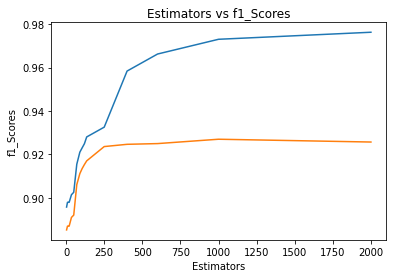

In [ ]:
estimators = [3,9,11,15,20,35,50,70,90,105,120,135,250,400,600,1000,2000]
train_scores = []
test_scores = []
for i in estimators:
    clf = XGBClassifier(learning_rate=0.01,  
                      n_estimators=i, 
                      reg_alpha = 0.3,
                      gamma=10,verbose=10)
    clf.fit(df_final_train,y_train)
    train_sc = f1_score(y_train,clf.predict(df_final_train))
    test_sc = f1_score(y_test,clf.predict(df_final_test))
    test_scores.append(test_sc)
    train_scores.append(train_sc)
    print('Estimators = ',i,'Train Score',train_sc,'test Score',test_sc)
plt.plot(estimators,train_scores,label='Train Score')
plt.plot(estimators,test_scores,label='Test Score')
plt.xlabel('Estimators')
plt.ylabel('f1_Scores')
plt.title('Estimators vs f1_Scores')

depth =  3 Train Score 0.9210178417297629 test Score 0.911597658790375
depth =  9 Train Score 0.9730725977758341 test Score 0.9314508400945506
depth =  11 Train Score 0.9764028030106412 test Score 0.9316857373771747
depth =  15 Train Score 0.9784342565929853 test Score 0.9315888962045749
depth =  20 Train Score 0.9785929554563626 test Score 0.9315580471852372
depth =  35 Train Score 0.978542728138851 test Score 0.9316313743814115


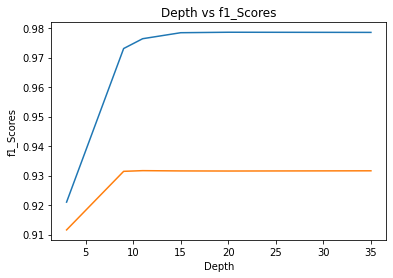

In [ ]:
depths = [3,9,11,15,20,35]
train_scores = []
test_scores = []
for i in depths:
    clf = XGBClassifier(learning_rate=0.01,  
                      max_depth=i, 
                      reg_alpha = 0.3,
                      gamma=10,verbose=10, n_jobs=-1,random_state=25)
    clf.fit(df_final_train,y_train)
    train_sc = f1_score(y_train,clf.predict(df_final_train))
    test_sc = f1_score(y_test,clf.predict(df_final_test))
    test_scores.append(test_sc)
    train_scores.append(train_sc)
    print('depth = ',i,'Train Score',train_sc,'test Score',test_sc)
plt.plot(depths,train_scores,label='Train Score')
plt.plot(depths,test_scores,label='Test Score')
plt.xlabel('Depth')
plt.ylabel('f1_Scores')
plt.title('Depth vs f1_Scores')
plt.show()

In [ ]:
from sklearn.model_selection import RandomizedSearchCV
clf = xgb.XGBClassifier()
param_dist = {"n_estimators":[105,115,120,130],
              "max_depth": [7,8,9,10]}
model = RandomizedSearchCV(clf, param_distributions=param_dist,
                                   n_jobs=-1,cv=3,scoring='f1',random_state=25,return_train_score=True,verbose=10)


model.fit(df_final_train,y_train)
print('mean test scores',model.cv_results_['mean_test_score'])
print('mean train scores',model.cv_results_['mean_train_score'])

Fitting 3 folds for each of 10 candidates, totalling 30 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  4.0min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  8.1min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed: 12.4min
[Parallel(n_jobs=-1)]: Done  21 tasks      | elapsed: 19.0min
[Parallel(n_jobs=-1)]: Done  30 out of  30 | elapsed: 26.4min finished


mean test scores [0.97950939 0.97930391 0.97769998 0.97855835 0.97966677 0.97936301
 0.9790094  0.97805321 0.97995505 0.97900449]
mean train scores [0.9959392  0.99445459 0.98431248 0.98740719 0.99503288 0.99258532
 0.98905957 0.98563026 0.99806493 0.99056325]


In [ ]:
model.best_params_

{'max_depth': 10, 'n_estimators': 130}

In [ ]:
clf = XGBClassifier(learning_rate=0.01,  
                      max_depth=10,n_estimators = 130,
                      gamma=10,verbose=10, n_jobs=-1,random_state=25)
clf.fit(df_final_train,y_train)
train_best = f1_score(y_train,clf.predict(df_final_train))
test_best = f1_score(y_test,clf.predict(df_final_test))

In [ ]:
y_train_pred = clf.predict(df_final_train)
y_test_pred = clf.predict(df_final_test)

In [ ]:
train_best,test_best

(0.9753937314829253, 0.9316270255307371)

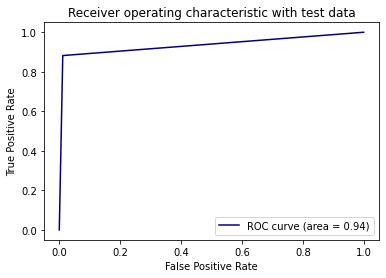

In [ ]:
from sklearn.metrics import roc_curve, auc
fpr,tpr,ths = roc_curve(y_test,y_test_pred)
auc_sc = auc(fpr, tpr)
plt.plot(fpr, tpr, color='navy',label='ROC curve (area = %0.2f)' % auc_sc)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic with test data')
plt.legend()
plt.show()

Train confusion_matrix


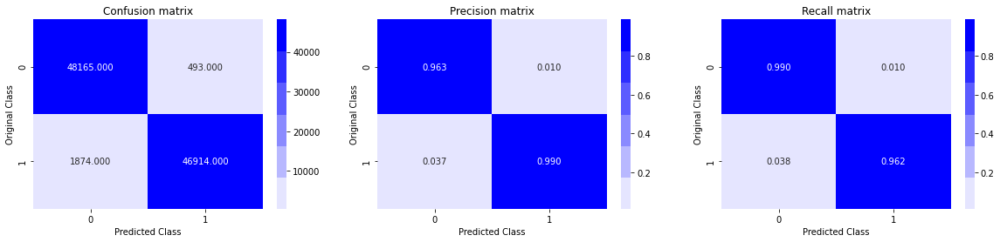

Test confusion_matrix


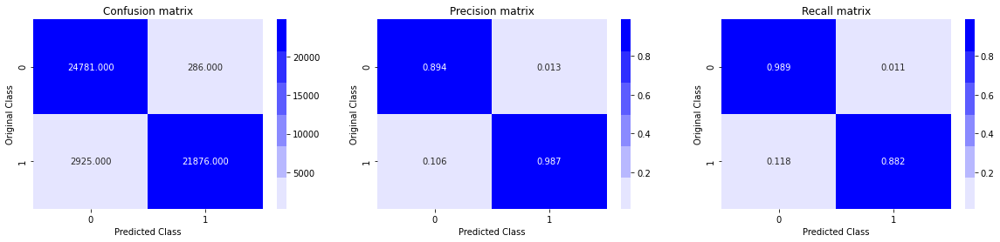

In [ ]:
print('Train confusion_matrix')
plot_confusion_matrix(y_train,y_train_pred)
print('Test confusion_matrix')
plot_confusion_matrix(y_test,y_test_pred)

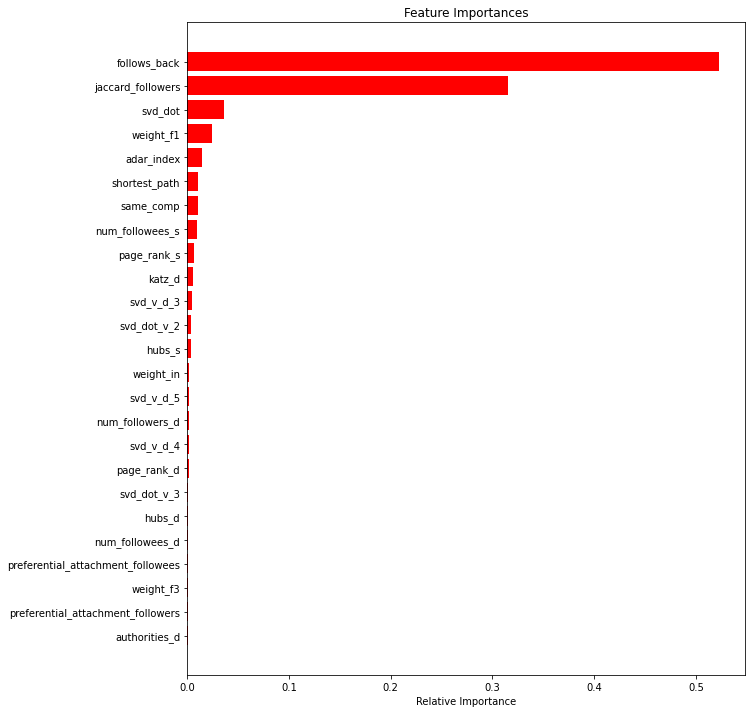

In [ ]:
features = df_final_train.columns
importances = clf.feature_importances_
indices = (np.argsort(importances))[-25:]
plt.figure(figsize=(10,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='r', align='center')
plt.yticks(range(len(indices)), [features[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show() 

Train confusion_matrix


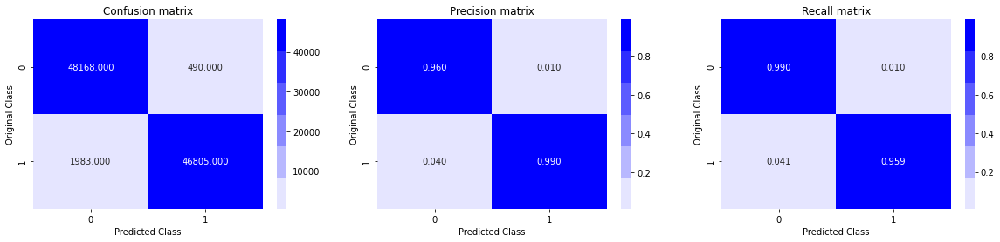

Test confusion_matrix


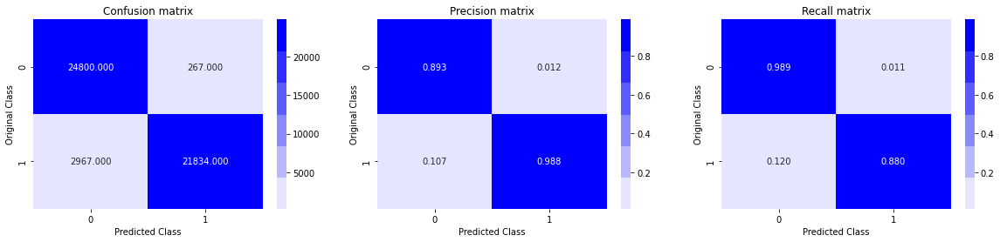

In [ ]:
print('Train confusion_matrix')
plot_confusion_matrix(y_train,y_train_pred)
print('Test confusion_matrix')
plot_confusion_matrix(y_test,y_test_pred)

In [1]:
from prettytable import PrettyTable


x = PrettyTable()
x.field_names = ["Vectorizer", "Model", "Hyper Parameter", "F1-Score"]

x.add_row(["Previous Graph Based features + Two new features", "XGBoost", "Max Depth:10 , Estimators : 130", 0.94])

print(x)

+--------------------------------------------------+---------+---------------------------------+----------+
|                    Vectorizer                    |  Model  |         Hyper Parameter         | F1-Score |
+--------------------------------------------------+---------+---------------------------------+----------+
| Previous Graph Based features + Two new features | XGBoost | Max Depth:10 , Estimators : 130 |   0.94   |
+--------------------------------------------------+---------+---------------------------------+----------+
